In [14]:
import tensorflow as tf
import glob
import tensorflow.keras.backend as K
import matplotlib.pyplot as plt
import numpy as np
import imageio
import os
import datetime
import time
import PIL
import pprint

from cv2 import imread, cvtColor, resize, INTER_CUBIC, COLOR_BGR2RGB, blur
from tensorflow.keras import layers
pp = pprint.PrettyPrinter(indent=4)


# Load and prepare the dataset

In [15]:
DATA_PATH = 'D:/Astor/Download/dataset/CelebA/Img/img_align_celeba/'
# EVAL_PATH = 'D:/Astor/Download/dataset/CelebA/Eval/list_eval_partition.txt'
EVAL_PATH = 'front_face.txt'
with open(EVAL_PATH, 'r') as f:
    lines = f.readlines()
    num_images = len(lines)
#     lines.sort(key=lambda tup: tup[0])
    train_set = []
    valid_set = []
    test_set = []
    for sample in lines:
        train_set.append('/'.join(sample[:-1].split('\\')))

In [16]:
# Check data
print('Total {} samples'.format(num_images))
print(imread(train_set[0]).shape)

Total 176211 samples
(218, 178, 3)


In [17]:
FILE_NAME = 'Train.tfrecords'
if os.path.isfile(DATA_PATH+FILE_NAME):
    train_dataset = tf.data.TFRecordDataset(DATA_PATH+FILE_NAME)
    feature_description={
        'image_raw' : tf.io.FixedLenFeature([], tf.string)
    }
    def _parse_function(exam_proto):
        return tf.io.parse_single_example(exam_proto, feature_description)
    def _pre_process(exam_proto):
        exam_proto = tf.io.decode_raw(exam_proto['image_raw'], 'uint8')
        return (tf.dtypes.cast(tf.reshape(exam_proto, [64,64,3]), tf.float32) - 127.5) / 127.5

    train_dataset = train_dataset.map(_parse_function)
    train_dataset = train_dataset.map(_pre_process)

In [22]:
# Batch and shuffle the data
BUFFER_SIZE = 60000
BATCH_SIZE = 256
# train_dataset = tf.data.Dataset.from_tensor_slices(train_data).shuffle(BUFFER_SIZE).batch(BATCH_SIZE)
train_dataset = train_dataset.shuffle(BUFFER_SIZE).batch(BATCH_SIZE)
# Data augmentation
def flip(x):
    return tf.image.random_flip_left_right(x)
train_dataset = train_dataset.map(lambda x: tf.cond(tf.random.uniform([], 0, 1) > 0.75, lambda: flip(x), lambda: x), num_parallel_calls=4)

In [23]:
current_time = datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
print('current_time:', current_time)

current_time: 20191028-083249


# Generator

In [24]:
img_size = 64
def make_generator_model():
    model = tf.keras.Sequential()
    model.add(layers.Dense(img_size//8*img_size//8*256, use_bias=False, input_shape=(100,)))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU(0.2))

    model.add(layers.Reshape((img_size//8, img_size//8, 256)))
    assert model.output_shape == (None, img_size//8, img_size//8, 256) # Note: None is the batch size

    model.add(layers.Dropout(0.3))
    model.add(layers.Conv2DTranspose(128, (5, 5), strides=(1, 1), padding='same', use_bias=False))
    assert model.output_shape == (None, img_size//8, img_size//8, 128)
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU(0.2))

    model.add(layers.Dropout(0.3))
    model.add(layers.Conv2DTranspose(64, (5, 5), strides=(2, 2), padding='same', use_bias=False))
    assert model.output_shape == (None, img_size//4, img_size//4, 64)
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU(0.2))

    model.add(layers.Dropout(0.3))
    model.add(layers.Conv2DTranspose(32, (5, 5), strides=(2, 2), padding='same', use_bias=False))
    assert model.output_shape == (None, img_size//2, img_size//2, 32)
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU(0.2))

    model.add(layers.Conv2DTranspose(3, (5, 5), strides=(2, 2), padding='same', use_bias=False, activation='tanh'))
    assert model.output_shape == (None, img_size, img_size, 3), model.output_shape

    return model

(1, 64, 64, 3)


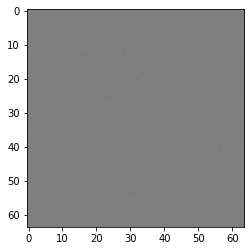

In [25]:
# Check generator
generator = make_generator_model()

noise = tf.random.normal([1, 100])
generated_image = generator(noise, training=False)
print(generated_image.shape)

plt.imshow(((generated_image[0].numpy()+1.0)*127.5).astype(np.uint8))

# Discriminator

In [26]:
def make_discriminator_model():
    model = tf.keras.Sequential()
    model.add(layers.Conv2D(64, (5, 5), strides=(2, 2), padding='same',
                                     input_shape=[img_size, img_size, 3]))
    model.add(layers.LeakyReLU(0.2))
    model.add(layers.Dropout(0.3))

    model.add(layers.Conv2D(128, (5, 5), strides=(2, 2), padding='same'))
    model.add(layers.LeakyReLU(0.2))
    model.add(layers.Dropout(0.3))

    model.add(layers.Conv2D(256, (5, 5), strides=(2, 2), padding='same'))
    model.add(layers.LeakyReLU(0.2))
    model.add(layers.Dropout(0.3))

    model.add(layers.Flatten())
    model.add(layers.Dense(1))

    return model

In [27]:
# Check discriminator
discriminator = make_discriminator_model()
decision = discriminator(generated_image)
print (decision)

tf.Tensor([[-0.000121]], shape=(1, 1), dtype=float32)


# Define the loss and optimizers

In [28]:
smooth = 0.9
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)
# Generator loss
def generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output)*smooth, fake_output)

# Discriminator loss
def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output)*smooth, real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    total_loss = real_loss + fake_loss
    return total_loss

In [29]:
# Optimizers
beta1 = 0.5
learning_rate = 0.0002
generator_optimizer = tf.keras.optimizers.Adam(learning_rate, beta_1=beta1)
discriminator_optimizer = tf.keras.optimizers.Adam(learning_rate, beta_1=beta1)
# generator_optimizer = tf.keras.optimizers.SGD(lr=0.01, momentum=0.9, decay=1e-6, nesterov=True)
# discriminator_optimizer = tf.keras.optimizers.SGD(lr=1e-5, momentum=0.9, decay=1e-6, nesterov=True)

# Save checkpoints

In [30]:
checkpoint_dir = './training_checkpoints'
os.makedirs(os.path.join(checkpoint_dir, current_time))
checkpoint_prefix = os.path.join(checkpoint_dir, current_time, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

# Define the training loop

In [31]:
EPOCHS = 200
noise_dim = 100
num_examples_to_generate = 16

# We will reuse this seed overtime (so it's easier)
# to visualize progress in the animated GIF)
seed = tf.random.normal([num_examples_to_generate, noise_dim])

In [32]:
base = cvtColor(imread('base.png'), COLOR_BGR2RGB)
def generate_and_save_images(model, epoch, test_input):
    print('generate_and_save_images')
    # Notice `training` is set to False.
    # This is so all layers run in inference mode (batchnorm).
    predictions = model(test_input, training=False)
    # print(predictions)

    fig = plt.figure(figsize=(4,4))

    for i in range(predictions.shape[0]):
        plt.subplot(4, 4, i+1)
        plt.imshow(((predictions[i].numpy()+1.0)*127.5).astype(np.uint8))
        plt.axis('off')
    
    dir_path = os.path.join(checkpoint_dir, current_time, 'image_at_epoch_{:04d}.png'.format(epoch))
    plt.savefig(dir_path)
    plt.show()
    
    fig = plt.figure()
    plt.imshow(base)
    plt.show()

@tf.function
def train_step(images):
    noise = tf.random.normal([BATCH_SIZE, noise_dim])

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:        
        generated_images = generator(noise, training=True)

        real_output = discriminator(images, training=True)
        fake_output = discriminator(generated_images, training=True)

        gen_loss = generator_loss(fake_output)
        disc_loss = discriminator_loss(real_output, fake_output)

    gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)
    
    tf.cond(gen_loss > disc_loss, 
            lambda: generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables)), 
            lambda: discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables)))
    
    return gen_loss, disc_loss, gradients_of_generator, gradients_of_discriminator


def train(dataset, epochs):
    steps = 0
    for epoch in range(epochs):
        start = time.time()

        for image_batch in dataset:
            steps += 1
            gen_loss, disc_loss, gradients_of_generator, gradients_of_discriminator = train_step(image_batch)
            if steps % 50 == 0: 
                tf.print('Gen_loss: ', gen_loss, 'Disc_loss: ', disc_loss)
                with Gen_writer.as_default():
                    tf.summary.scalar('loss', gen_loss, step=steps)
                with Dis_writer.as_default():
                    tf.summary.scalar('loss', disc_loss, step=steps)

        # Produce images for the GIF as we go
        # display.clear_output(wait=True)
        generate_and_save_images(generator,
                                 epoch + 1,
                                 seed)

        # Save the model every 15 epochs
#         if (epoch + 1) % 15 == 0:
        checkpoint.save(file_prefix = checkpoint_prefix)

        print ('Time for epoch {} is {} sec'.format(epoch + 1, time.time()-start))

    # Generate after the final epoch
    #display.clear_output(wait=True)
    generate_and_save_images(generator,
                           epochs,
                           seed)

In [33]:
# Tensorboard
Gen_log_dir = 'log/' + current_time + '/Gen'
Dis_log_dir = 'log/' + current_time + '/Dis'
Gen_writer = tf.summary.create_file_writer(Gen_log_dir)
Dis_writer = tf.summary.create_file_writer(Dis_log_dir)

# Train the model

Gen_loss:  0.858448744 Disc_loss:  1.00917852
Gen_loss:  1.5264225 Disc_loss:  0.903383374
Gen_loss:  1.76818144 Disc_loss:  0.99066627
Gen_loss:  1.02281857 Disc_loss:  1.16675377
Gen_loss:  1.31227803 Disc_loss:  1.02706718
Gen_loss:  1.14076614 Disc_loss:  1.01545715
Gen_loss:  1.29244614 Disc_loss:  1.04016542
Gen_loss:  1.30551207 Disc_loss:  1.02005565
Gen_loss:  0.956439555 Disc_loss:  1.08841407
Gen_loss:  1.04385233 Disc_loss:  1.25400269
Gen_loss:  1.0188036 Disc_loss:  1.00178182
Gen_loss:  1.31222546 Disc_loss:  0.950724363
Gen_loss:  1.31592965 Disc_loss:  1.25830925
generate_and_save_images


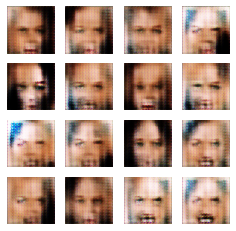

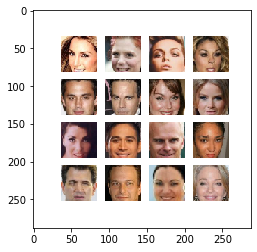

Time for epoch 1 is 214.12918090820312 sec
Gen_loss:  0.873271465 Disc_loss:  1.09235191
Gen_loss:  0.995817065 Disc_loss:  1.15106845
Gen_loss:  1.18631518 Disc_loss:  1.0042609
Gen_loss:  0.935331762 Disc_loss:  1.18448424
Gen_loss:  1.18400359 Disc_loss:  0.948257744
Gen_loss:  0.858993828 Disc_loss:  1.20470595
Gen_loss:  1.25832117 Disc_loss:  1.10174298
Gen_loss:  1.206563 Disc_loss:  1.02776635
Gen_loss:  1.04561388 Disc_loss:  1.01232147
Gen_loss:  1.32801199 Disc_loss:  1.35578895
Gen_loss:  1.50014472 Disc_loss:  1.07191432
Gen_loss:  1.0323869 Disc_loss:  1.04172111
Gen_loss:  1.15948784 Disc_loss:  0.950612307
Gen_loss:  1.45738268 Disc_loss:  1.01137972
generate_and_save_images


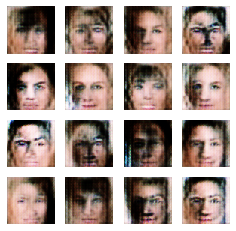

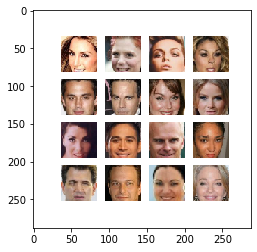

Time for epoch 2 is 211.05977749824524 sec
Gen_loss:  1.22788119 Disc_loss:  1.06116509
Gen_loss:  0.993637919 Disc_loss:  1.13010764
Gen_loss:  0.995246887 Disc_loss:  1.14083517
Gen_loss:  1.16867399 Disc_loss:  1.06121933
Gen_loss:  1.01732373 Disc_loss:  1.05867434
Gen_loss:  1.4283762 Disc_loss:  1.0782007
Gen_loss:  1.10848463 Disc_loss:  1.13199103
Gen_loss:  0.918273449 Disc_loss:  1.1444788
Gen_loss:  1.02914095 Disc_loss:  0.978805661
Gen_loss:  1.34206271 Disc_loss:  1.12101972
Gen_loss:  0.980901539 Disc_loss:  1.19234705
Gen_loss:  1.30606222 Disc_loss:  1.08212018
Gen_loss:  1.34848726 Disc_loss:  0.955834627
Gen_loss:  0.984496653 Disc_loss:  1.02164793
generate_and_save_images


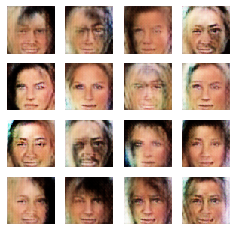

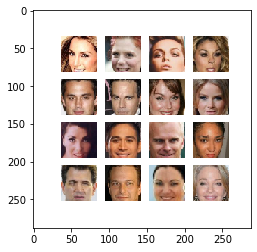

Time for epoch 3 is 210.58067417144775 sec
Gen_loss:  1.14546156 Disc_loss:  1.0120517
Gen_loss:  1.02762043 Disc_loss:  1.10842395
Gen_loss:  0.638875782 Disc_loss:  1.32967889
Gen_loss:  1.0687499 Disc_loss:  0.99428916
Gen_loss:  0.982347071 Disc_loss:  1.03662264
Gen_loss:  1.12540781 Disc_loss:  1.07582819
Gen_loss:  1.04422951 Disc_loss:  1.05392444
Gen_loss:  1.13922477 Disc_loss:  1.10761237
Gen_loss:  0.872005224 Disc_loss:  1.06711519
Gen_loss:  1.2155751 Disc_loss:  1.08224487
Gen_loss:  1.14667797 Disc_loss:  1.02727294
Gen_loss:  1.07819211 Disc_loss:  1.19348073
Gen_loss:  1.23380327 Disc_loss:  1.06147623
Gen_loss:  1.00958645 Disc_loss:  1.23137534
generate_and_save_images


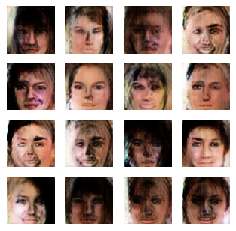

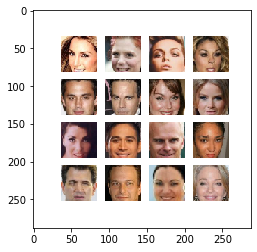

Time for epoch 4 is 210.20570850372314 sec
Gen_loss:  1.30376685 Disc_loss:  1.32294595
Gen_loss:  1.27004862 Disc_loss:  1.06960893
Gen_loss:  0.956089497 Disc_loss:  1.09370852
Gen_loss:  0.999745 Disc_loss:  1.17478573
Gen_loss:  1.06808019 Disc_loss:  1.17584562
Gen_loss:  1.19764924 Disc_loss:  1.22487617
Gen_loss:  1.17377555 Disc_loss:  1.14952803
Gen_loss:  1.10329163 Disc_loss:  1.15916371
Gen_loss:  1.06671822 Disc_loss:  1.15873551
Gen_loss:  1.04072094 Disc_loss:  1.11548436
Gen_loss:  1.05719078 Disc_loss:  1.00188911
Gen_loss:  1.03698838 Disc_loss:  1.06489
Gen_loss:  1.05707037 Disc_loss:  1.22361147
generate_and_save_images


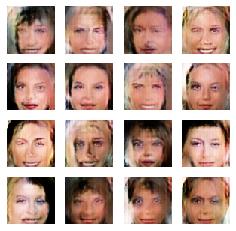

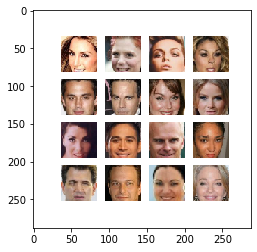

Time for epoch 5 is 210.03527927398682 sec
Gen_loss:  1.3683877 Disc_loss:  1.00262475
Gen_loss:  1.06192923 Disc_loss:  1.05761743
Gen_loss:  1.04548585 Disc_loss:  1.04287219
Gen_loss:  1.15086472 Disc_loss:  1.21932828
Gen_loss:  1.21554375 Disc_loss:  1.00261843
Gen_loss:  1.32894635 Disc_loss:  1.16301119
Gen_loss:  1.39195228 Disc_loss:  1.00844312
Gen_loss:  1.34141386 Disc_loss:  1.07242966
Gen_loss:  1.11258411 Disc_loss:  1.11990488
Gen_loss:  1.25809765 Disc_loss:  1.30661738
Gen_loss:  1.01666117 Disc_loss:  1.0436151
Gen_loss:  1.03681886 Disc_loss:  1.07843757
Gen_loss:  1.5996747 Disc_loss:  1.16827607
Gen_loss:  1.03931141 Disc_loss:  1.09893703
generate_and_save_images


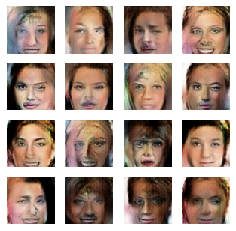

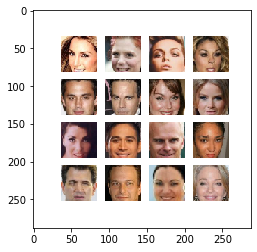

Time for epoch 6 is 210.09667372703552 sec
Gen_loss:  1.06657898 Disc_loss:  1.1055032
Gen_loss:  1.74425292 Disc_loss:  1.25321424
Gen_loss:  1.20931029 Disc_loss:  1.1079365
Gen_loss:  0.986810744 Disc_loss:  1.15367568
Gen_loss:  1.47219229 Disc_loss:  1.20492148
Gen_loss:  1.1635859 Disc_loss:  0.977617264
Gen_loss:  1.09161758 Disc_loss:  1.189574
Gen_loss:  1.217237 Disc_loss:  1.14524698
Gen_loss:  1.08131039 Disc_loss:  1.12583101
Gen_loss:  1.32915902 Disc_loss:  1.15433204
Gen_loss:  1.03111255 Disc_loss:  1.14226902
Gen_loss:  1.14968324 Disc_loss:  1.12961841
Gen_loss:  1.24934864 Disc_loss:  1.01735616
Gen_loss:  0.983211815 Disc_loss:  1.04334807
generate_and_save_images


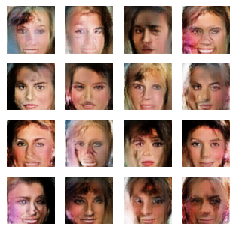

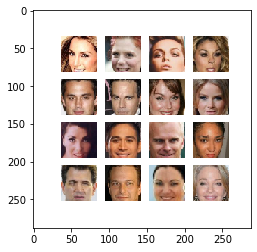

Time for epoch 7 is 209.79201650619507 sec
Gen_loss:  1.08494735 Disc_loss:  1.11179566
Gen_loss:  1.28691816 Disc_loss:  1.0740087
Gen_loss:  1.20992708 Disc_loss:  1.00122643
Gen_loss:  1.04705369 Disc_loss:  1.14247847
Gen_loss:  1.00910807 Disc_loss:  1.19913507
Gen_loss:  0.95611006 Disc_loss:  1.07812786
Gen_loss:  1.49833989 Disc_loss:  1.16992056
Gen_loss:  1.20608294 Disc_loss:  1.10558903
Gen_loss:  1.25893605 Disc_loss:  1.2669425
Gen_loss:  0.787647426 Disc_loss:  1.1862179
Gen_loss:  1.65337586 Disc_loss:  1.29300332
Gen_loss:  1.55333495 Disc_loss:  1.44430244
Gen_loss:  1.17760694 Disc_loss:  1.04723346
Gen_loss:  1.09273648 Disc_loss:  1.05373192
generate_and_save_images


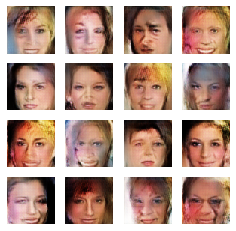

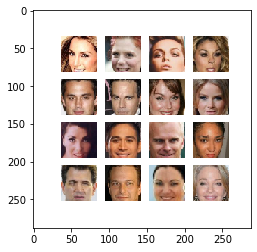

Time for epoch 8 is 209.33582711219788 sec
Gen_loss:  0.906229854 Disc_loss:  1.08803594
Gen_loss:  1.58043647 Disc_loss:  1.55706167
Gen_loss:  1.06969094 Disc_loss:  1.09231794
Gen_loss:  1.13146734 Disc_loss:  1.18545103
Gen_loss:  0.994276 Disc_loss:  1.14707196
Gen_loss:  1.54103434 Disc_loss:  1.20701432
Gen_loss:  1.07054758 Disc_loss:  1.08404839
Gen_loss:  1.5362035 Disc_loss:  1.29682469
Gen_loss:  1.69924879 Disc_loss:  1.61615467
Gen_loss:  1.04371715 Disc_loss:  1.19116032
Gen_loss:  0.998196125 Disc_loss:  1.20635307
Gen_loss:  1.18135774 Disc_loss:  1.05872738
Gen_loss:  1.08849633 Disc_loss:  1.03417265
Gen_loss:  1.28878093 Disc_loss:  1.0134474
generate_and_save_images


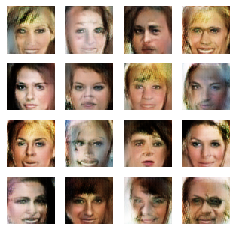

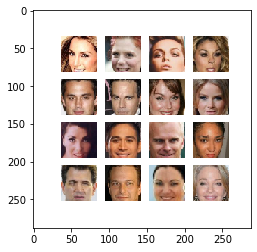

Time for epoch 9 is 209.91817808151245 sec
Gen_loss:  1.11164892 Disc_loss:  1.12206173
Gen_loss:  1.14173806 Disc_loss:  1.15501237
Gen_loss:  1.23665261 Disc_loss:  1.05157697
Gen_loss:  1.55948865 Disc_loss:  1.12175226
Gen_loss:  1.28153419 Disc_loss:  1.25840068
Gen_loss:  1.17153406 Disc_loss:  1.0803293
Gen_loss:  1.1743207 Disc_loss:  1.01000094
Gen_loss:  1.45382857 Disc_loss:  1.13069558
Gen_loss:  1.13943195 Disc_loss:  1.17547202
Gen_loss:  1.16692173 Disc_loss:  1.07777131
Gen_loss:  1.07784307 Disc_loss:  1.05557334
Gen_loss:  1.05191588 Disc_loss:  1.18524551
Gen_loss:  1.11618972 Disc_loss:  1.03291154
generate_and_save_images


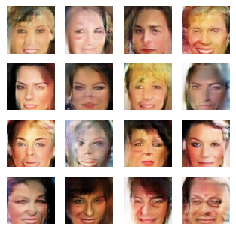

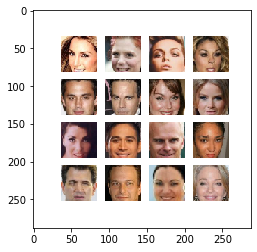

Time for epoch 10 is 210.1085216999054 sec
Gen_loss:  1.69767344 Disc_loss:  1.14887536
Gen_loss:  0.902975202 Disc_loss:  1.07191873
Gen_loss:  1.09110546 Disc_loss:  1.07351339
Gen_loss:  1.27988565 Disc_loss:  1.02630234
Gen_loss:  1.10125625 Disc_loss:  1.1346401
Gen_loss:  1.47484469 Disc_loss:  1.47233438
Gen_loss:  1.30586994 Disc_loss:  1.06884146
Gen_loss:  1.14228678 Disc_loss:  1.09936297
Gen_loss:  1.09801459 Disc_loss:  1.30126417
Gen_loss:  1.2091527 Disc_loss:  1.04653609
Gen_loss:  1.16249728 Disc_loss:  1.12016964
Gen_loss:  1.08723152 Disc_loss:  1.08556032
Gen_loss:  1.0060178 Disc_loss:  1.11103606
Gen_loss:  1.13192332 Disc_loss:  1.11734211
generate_and_save_images


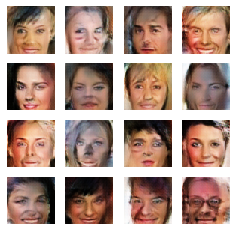

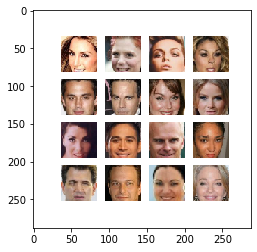

Time for epoch 11 is 209.43763995170593 sec
Gen_loss:  1.07053196 Disc_loss:  1.11016321
Gen_loss:  1.26911938 Disc_loss:  1.23097706
Gen_loss:  1.36951399 Disc_loss:  1.28215408
Gen_loss:  1.02957654 Disc_loss:  1.19017768
Gen_loss:  1.13911343 Disc_loss:  1.10975528
Gen_loss:  1.09332609 Disc_loss:  1.15198302
Gen_loss:  1.10472488 Disc_loss:  1.12103736
Gen_loss:  1.27323759 Disc_loss:  1.1605227
Gen_loss:  1.28441036 Disc_loss:  1.14293385
Gen_loss:  1.15146697 Disc_loss:  1.11987948
Gen_loss:  1.29216385 Disc_loss:  1.15719879
Gen_loss:  1.3511014 Disc_loss:  1.0447278
Gen_loss:  1.06122422 Disc_loss:  1.18796349
Gen_loss:  1.34588516 Disc_loss:  1.19443417
generate_and_save_images


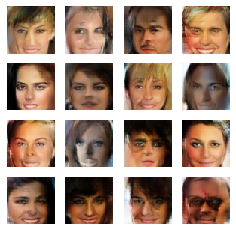

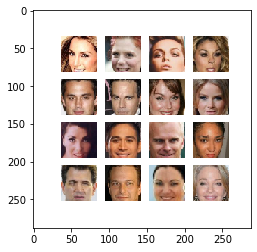

Time for epoch 12 is 210.73292231559753 sec
Gen_loss:  1.20439374 Disc_loss:  1.06080008
Gen_loss:  1.34871507 Disc_loss:  1.31848693
Gen_loss:  1.05934334 Disc_loss:  1.16820526
Gen_loss:  1.05707479 Disc_loss:  1.10953665
Gen_loss:  1.19796038 Disc_loss:  1.15636516
Gen_loss:  1.11226821 Disc_loss:  1.13141203
Gen_loss:  0.985910296 Disc_loss:  1.0959239
Gen_loss:  0.843283176 Disc_loss:  1.4134798
Gen_loss:  1.02272761 Disc_loss:  1.08908105
Gen_loss:  1.06308079 Disc_loss:  1.0738833
Gen_loss:  1.11583376 Disc_loss:  1.08335924
Gen_loss:  1.06006205 Disc_loss:  1.06360078
Gen_loss:  0.941826642 Disc_loss:  1.10495341
Gen_loss:  1.40134549 Disc_loss:  1.05700421
generate_and_save_images


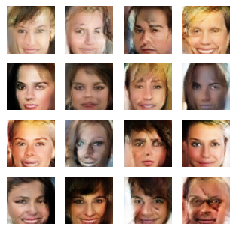

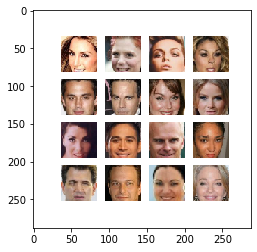

Time for epoch 13 is 210.21849513053894 sec
Gen_loss:  1.24700093 Disc_loss:  1.32380414
Gen_loss:  1.1774019 Disc_loss:  1.05458283
Gen_loss:  1.09942055 Disc_loss:  1.21039605
Gen_loss:  1.07736814 Disc_loss:  1.09415412
Gen_loss:  1.13849235 Disc_loss:  1.07337868
Gen_loss:  1.27238059 Disc_loss:  1.21791148
Gen_loss:  1.11279845 Disc_loss:  1.16732919
Gen_loss:  1.33393991 Disc_loss:  1.3496182
Gen_loss:  0.985670805 Disc_loss:  1.22182477
Gen_loss:  1.13188899 Disc_loss:  1.16169846
Gen_loss:  1.10721636 Disc_loss:  1.22359014
Gen_loss:  1.23766398 Disc_loss:  1.10825562
Gen_loss:  1.18624949 Disc_loss:  1.06363487
generate_and_save_images


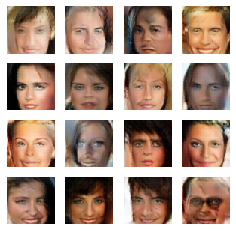

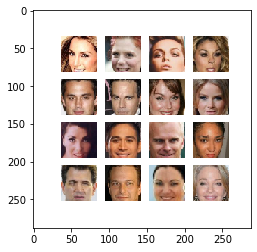

Time for epoch 14 is 209.22100067138672 sec
Gen_loss:  1.04007971 Disc_loss:  1.08681917
Gen_loss:  1.15239966 Disc_loss:  1.06816959
Gen_loss:  1.12014723 Disc_loss:  1.10179591
Gen_loss:  1.15044868 Disc_loss:  1.13567972
Gen_loss:  1.19022894 Disc_loss:  1.0397203
Gen_loss:  1.10331547 Disc_loss:  1.14418292
Gen_loss:  0.994582891 Disc_loss:  1.12622118
Gen_loss:  1.15823507 Disc_loss:  1.11287141
Gen_loss:  1.02504897 Disc_loss:  1.112409
Gen_loss:  0.963961899 Disc_loss:  1.09889495
Gen_loss:  1.15032077 Disc_loss:  1.0694232
Gen_loss:  1.4669112 Disc_loss:  1.43225455
Gen_loss:  1.31348264 Disc_loss:  1.07948565
Gen_loss:  1.15501213 Disc_loss:  1.10870576
generate_and_save_images


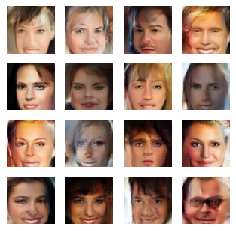

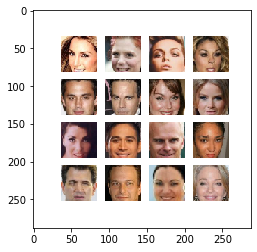

Time for epoch 15 is 210.54333972930908 sec
Gen_loss:  1.07445025 Disc_loss:  1.08244884
Gen_loss:  1.07358503 Disc_loss:  1.12808299
Gen_loss:  1.78639352 Disc_loss:  1.23353267
Gen_loss:  1.2607106 Disc_loss:  1.25504208
Gen_loss:  0.993218303 Disc_loss:  1.10816908
Gen_loss:  0.966996312 Disc_loss:  1.16720164
Gen_loss:  1.16673231 Disc_loss:  1.15805113
Gen_loss:  1.14648163 Disc_loss:  1.12560165
Gen_loss:  1.17996395 Disc_loss:  1.0978024
Gen_loss:  1.06694007 Disc_loss:  1.1247189
Gen_loss:  1.11410737 Disc_loss:  1.25656092
Gen_loss:  1.1226573 Disc_loss:  1.1295507
Gen_loss:  1.25014055 Disc_loss:  1.06844294
Gen_loss:  1.19857311 Disc_loss:  1.10549617
generate_and_save_images


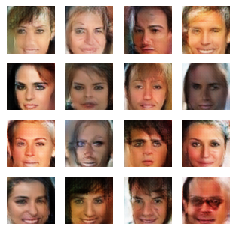

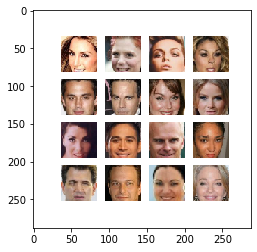

Time for epoch 16 is 210.14721727371216 sec
Gen_loss:  1.12932575 Disc_loss:  1.0279268
Gen_loss:  1.2610687 Disc_loss:  1.27390444
Gen_loss:  1.30615163 Disc_loss:  1.1042558
Gen_loss:  0.792149603 Disc_loss:  1.26751792
Gen_loss:  1.19125867 Disc_loss:  1.07647443
Gen_loss:  1.15904164 Disc_loss:  1.18522513
Gen_loss:  1.08578467 Disc_loss:  1.00655961
Gen_loss:  1.43161952 Disc_loss:  1.2103914
Gen_loss:  0.995369 Disc_loss:  1.0629282
Gen_loss:  1.11155558 Disc_loss:  1.18630815
Gen_loss:  1.22097874 Disc_loss:  1.19333863
Gen_loss:  1.15945351 Disc_loss:  1.10134745
Gen_loss:  1.09232223 Disc_loss:  1.10760045
Gen_loss:  1.27744055 Disc_loss:  1.08603561
generate_and_save_images


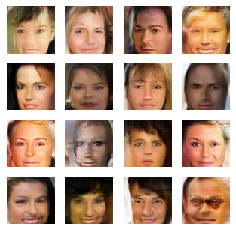

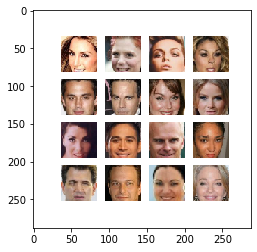

Time for epoch 17 is 209.7262568473816 sec
Gen_loss:  1.68732047 Disc_loss:  1.40299189
Gen_loss:  1.17120969 Disc_loss:  1.06733179
Gen_loss:  1.32466221 Disc_loss:  0.981271267
Gen_loss:  1.6318357 Disc_loss:  1.08054113
Gen_loss:  1.31992495 Disc_loss:  1.099859
Gen_loss:  0.956983864 Disc_loss:  1.18930578
Gen_loss:  1.0062151 Disc_loss:  1.26843143
Gen_loss:  1.22788787 Disc_loss:  1.18175411
Gen_loss:  1.07895017 Disc_loss:  1.09027755
Gen_loss:  1.19692755 Disc_loss:  1.06113398
Gen_loss:  1.23917139 Disc_loss:  1.09190607
Gen_loss:  1.21731496 Disc_loss:  1.02904177
Gen_loss:  1.26283622 Disc_loss:  1.14926529
Gen_loss:  1.08884358 Disc_loss:  1.06161404
generate_and_save_images


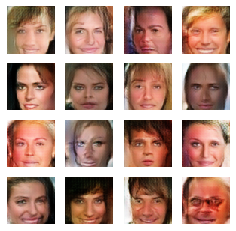

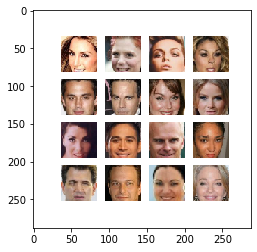

Time for epoch 18 is 210.9071433544159 sec
Gen_loss:  1.21165884 Disc_loss:  1.20401
Gen_loss:  1.01085675 Disc_loss:  1.12310982
Gen_loss:  1.22637808 Disc_loss:  1.10165119
Gen_loss:  1.27483749 Disc_loss:  1.26026821
Gen_loss:  1.10547042 Disc_loss:  1.10122907
Gen_loss:  1.06630325 Disc_loss:  1.15715766
Gen_loss:  1.3019613 Disc_loss:  1.05655706
Gen_loss:  1.02443027 Disc_loss:  1.07104111
Gen_loss:  1.48714292 Disc_loss:  1.23569465
Gen_loss:  1.05675757 Disc_loss:  1.22658
Gen_loss:  1.25663829 Disc_loss:  1.25047922
Gen_loss:  1.10764027 Disc_loss:  1.04435015
Gen_loss:  1.59351575 Disc_loss:  1.26722252
generate_and_save_images


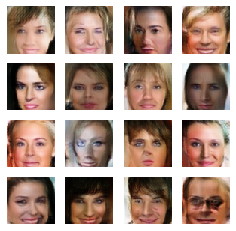

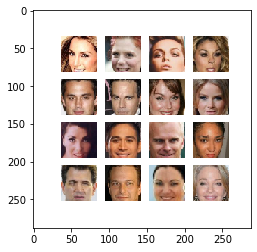

Time for epoch 19 is 210.25741815567017 sec
Gen_loss:  1.47308075 Disc_loss:  1.2517426
Gen_loss:  1.32498598 Disc_loss:  1.10013008
Gen_loss:  1.25984132 Disc_loss:  1.08211505
Gen_loss:  1.14541423 Disc_loss:  1.14240718
Gen_loss:  1.54977417 Disc_loss:  1.21878386
Gen_loss:  1.06713533 Disc_loss:  1.12242532
Gen_loss:  1.22315955 Disc_loss:  1.01646328
Gen_loss:  1.26173449 Disc_loss:  1.04766703
Gen_loss:  1.08188653 Disc_loss:  1.0811491
Gen_loss:  1.43151963 Disc_loss:  1.03962541
Gen_loss:  1.30017602 Disc_loss:  1.00569105
Gen_loss:  1.27823305 Disc_loss:  1.07847738
Gen_loss:  1.08703423 Disc_loss:  1.09827662
Gen_loss:  1.29946828 Disc_loss:  1.20833039
generate_and_save_images


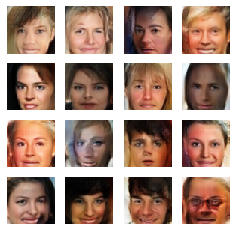

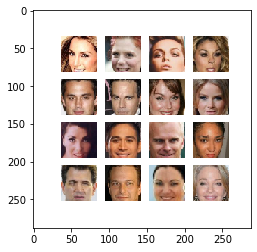

Time for epoch 20 is 210.00892782211304 sec
Gen_loss:  1.04604578 Disc_loss:  1.06587696
Gen_loss:  1.1428616 Disc_loss:  1.1702497
Gen_loss:  0.926957 Disc_loss:  1.15870857
Gen_loss:  1.05734801 Disc_loss:  1.14255548
Gen_loss:  1.35816109 Disc_loss:  1.11592424
Gen_loss:  1.17084265 Disc_loss:  1.17515063
Gen_loss:  1.04139602 Disc_loss:  1.09633112
Gen_loss:  1.49929643 Disc_loss:  1.05338097
Gen_loss:  1.27446759 Disc_loss:  1.16980147
Gen_loss:  1.30361223 Disc_loss:  1.20513105
Gen_loss:  1.20078695 Disc_loss:  1.10877836
Gen_loss:  1.01593578 Disc_loss:  1.10394263
Gen_loss:  1.26170468 Disc_loss:  1.10076737
Gen_loss:  1.34950352 Disc_loss:  1.17488277
generate_and_save_images


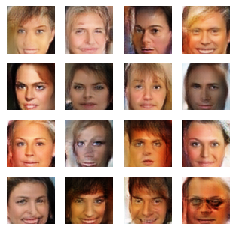

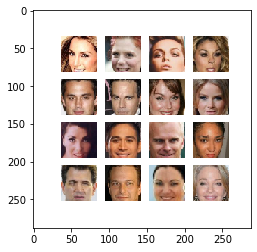

Time for epoch 21 is 210.44795894622803 sec
Gen_loss:  1.33100104 Disc_loss:  1.15801334
Gen_loss:  1.20862901 Disc_loss:  1.10110438
Gen_loss:  1.07901907 Disc_loss:  1.1034081
Gen_loss:  1.11615574 Disc_loss:  1.08041275
Gen_loss:  1.2729882 Disc_loss:  1.24375272
Gen_loss:  1.29548025 Disc_loss:  1.15112722
Gen_loss:  1.16426182 Disc_loss:  1.21425641
Gen_loss:  1.21372747 Disc_loss:  1.05909455
Gen_loss:  1.42157233 Disc_loss:  1.09055078
Gen_loss:  1.11923361 Disc_loss:  1.10053575
Gen_loss:  1.08903253 Disc_loss:  1.092103
Gen_loss:  1.09529889 Disc_loss:  1.1023047
Gen_loss:  0.9910146 Disc_loss:  1.06012273
Gen_loss:  1.1500411 Disc_loss:  1.18591309
generate_and_save_images


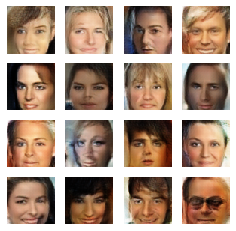

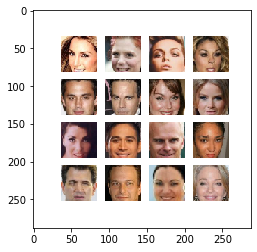

Time for epoch 22 is 209.93384075164795 sec
Gen_loss:  1.10948646 Disc_loss:  1.11198986
Gen_loss:  1.33675742 Disc_loss:  0.989485
Gen_loss:  1.01110637 Disc_loss:  1.15877914
Gen_loss:  1.20296311 Disc_loss:  1.05778861
Gen_loss:  0.883501172 Disc_loss:  1.10889935
Gen_loss:  1.23664057 Disc_loss:  1.01082754
Gen_loss:  1.21708858 Disc_loss:  1.29461849
Gen_loss:  1.33555877 Disc_loss:  1.13438892
Gen_loss:  1.09712279 Disc_loss:  1.17825735
Gen_loss:  1.14230776 Disc_loss:  1.05304503
Gen_loss:  1.22541547 Disc_loss:  1.19075525
Gen_loss:  1.2409699 Disc_loss:  1.17120552
Gen_loss:  0.938520133 Disc_loss:  1.15812695
generate_and_save_images


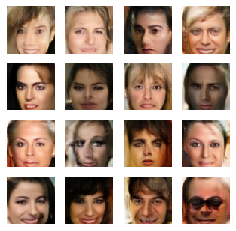

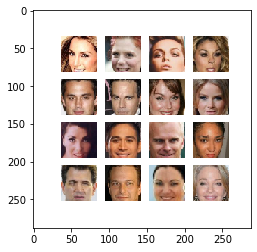

Time for epoch 23 is 210.2276167869568 sec
Gen_loss:  1.11958873 Disc_loss:  1.08978033
Gen_loss:  1.11778903 Disc_loss:  1.04359901
Gen_loss:  1.1655246 Disc_loss:  1.04423785
Gen_loss:  1.34659469 Disc_loss:  1.43951821
Gen_loss:  1.26079929 Disc_loss:  1.15440524
Gen_loss:  1.21316993 Disc_loss:  1.13834834
Gen_loss:  1.19434142 Disc_loss:  1.18220663
Gen_loss:  1.1216464 Disc_loss:  1.08924508
Gen_loss:  1.51310873 Disc_loss:  1.45693064
Gen_loss:  1.11584926 Disc_loss:  1.13634753
Gen_loss:  1.25236297 Disc_loss:  1.072384
Gen_loss:  1.44860184 Disc_loss:  1.09554148
Gen_loss:  1.37857187 Disc_loss:  1.32370257
Gen_loss:  1.41633058 Disc_loss:  1.14377713
generate_and_save_images


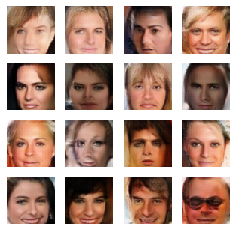

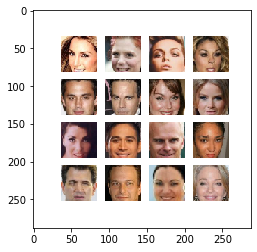

Time for epoch 24 is 210.67097806930542 sec
Gen_loss:  1.27944624 Disc_loss:  1.15293288
Gen_loss:  1.24124956 Disc_loss:  1.17419958
Gen_loss:  1.28350985 Disc_loss:  1.15926385
Gen_loss:  1.21081376 Disc_loss:  1.13185835
Gen_loss:  1.04159784 Disc_loss:  1.07018375
Gen_loss:  1.53561497 Disc_loss:  1.31756926
Gen_loss:  1.02772295 Disc_loss:  1.08992577
Gen_loss:  1.11092639 Disc_loss:  1.21533656
Gen_loss:  1.2325865 Disc_loss:  1.12730682
Gen_loss:  0.800298631 Disc_loss:  1.37666583
Gen_loss:  1.06933403 Disc_loss:  1.22023666
Gen_loss:  1.20117176 Disc_loss:  1.05707288
Gen_loss:  1.14129233 Disc_loss:  1.191535
Gen_loss:  1.20159125 Disc_loss:  1.05422258
generate_and_save_images


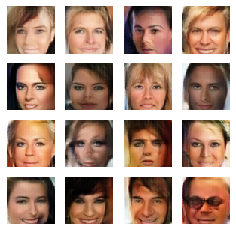

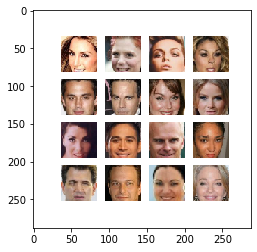

Time for epoch 25 is 210.4533977508545 sec
Gen_loss:  1.09655988 Disc_loss:  1.13099718
Gen_loss:  1.1825738 Disc_loss:  1.12176
Gen_loss:  1.06048286 Disc_loss:  1.09454894
Gen_loss:  1.08666074 Disc_loss:  1.14165735
Gen_loss:  1.21034098 Disc_loss:  1.1738205
Gen_loss:  1.3182714 Disc_loss:  1.06835294
Gen_loss:  1.13106108 Disc_loss:  1.13407779
Gen_loss:  1.17241061 Disc_loss:  1.1438843
Gen_loss:  1.14160621 Disc_loss:  1.08545899
Gen_loss:  1.02226293 Disc_loss:  1.0995183
Gen_loss:  1.08986616 Disc_loss:  1.08939147
Gen_loss:  1.11700487 Disc_loss:  1.18033886
Gen_loss:  1.23616803 Disc_loss:  1.19046569
Gen_loss:  1.14702547 Disc_loss:  1.04524755
generate_and_save_images


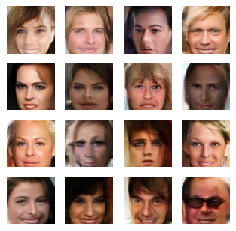

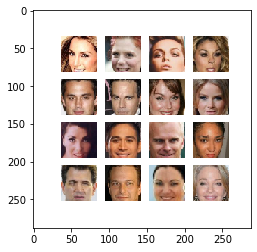

Time for epoch 26 is 209.93804025650024 sec
Gen_loss:  1.07625556 Disc_loss:  1.0941143
Gen_loss:  1.31426764 Disc_loss:  1.07689571
Gen_loss:  1.24802375 Disc_loss:  1.15427089
Gen_loss:  1.23738492 Disc_loss:  1.11999834
Gen_loss:  1.03389752 Disc_loss:  1.10949492
Gen_loss:  1.39894271 Disc_loss:  1.19246924
Gen_loss:  1.20717275 Disc_loss:  1.0828166
Gen_loss:  1.09475195 Disc_loss:  1.08498
Gen_loss:  1.11849988 Disc_loss:  1.08662474
Gen_loss:  1.33276427 Disc_loss:  1.1166687
Gen_loss:  1.24474442 Disc_loss:  1.05445516
Gen_loss:  1.22006166 Disc_loss:  1.06354511
Gen_loss:  1.23876691 Disc_loss:  1.10009873
Gen_loss:  0.981117785 Disc_loss:  1.10458422
generate_and_save_images


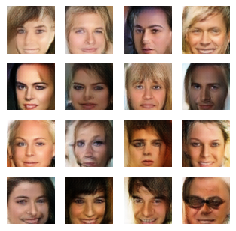

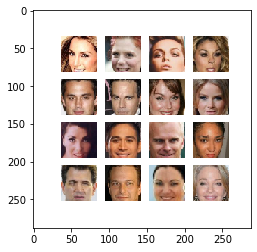

Time for epoch 27 is 211.32695078849792 sec
Gen_loss:  1.13794827 Disc_loss:  1.13612318
Gen_loss:  1.23555171 Disc_loss:  1.14632916
Gen_loss:  1.16193473 Disc_loss:  1.14699697
Gen_loss:  1.20429349 Disc_loss:  1.13729918
Gen_loss:  1.24050593 Disc_loss:  1.0047245
Gen_loss:  1.2371856 Disc_loss:  1.19778562
Gen_loss:  1.11686265 Disc_loss:  1.09334052
Gen_loss:  1.22347581 Disc_loss:  1.11399865
Gen_loss:  1.20080793 Disc_loss:  1.13989186
Gen_loss:  0.990830958 Disc_loss:  1.10415423
Gen_loss:  1.33915091 Disc_loss:  1.16210151
Gen_loss:  1.14094305 Disc_loss:  1.07689869
Gen_loss:  1.17591882 Disc_loss:  1.15738344
generate_and_save_images


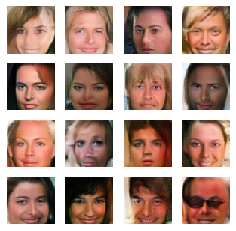

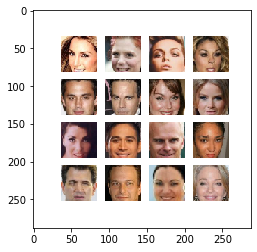

Time for epoch 28 is 211.56215572357178 sec
Gen_loss:  1.29682255 Disc_loss:  1.08924878
Gen_loss:  1.11741889 Disc_loss:  1.07952547
Gen_loss:  1.1672554 Disc_loss:  1.06394386
Gen_loss:  1.05498886 Disc_loss:  1.16666329
Gen_loss:  1.10700607 Disc_loss:  1.16785538
Gen_loss:  1.06672359 Disc_loss:  1.14157224
Gen_loss:  0.921903849 Disc_loss:  1.13049269
Gen_loss:  1.11104715 Disc_loss:  1.07150865
Gen_loss:  1.09332132 Disc_loss:  1.09117818
Gen_loss:  1.04183197 Disc_loss:  1.08944464
Gen_loss:  1.09614241 Disc_loss:  1.1550498
Gen_loss:  1.18935263 Disc_loss:  1.11631262
Gen_loss:  1.10417807 Disc_loss:  1.16211784
Gen_loss:  1.1454016 Disc_loss:  1.12617695
generate_and_save_images


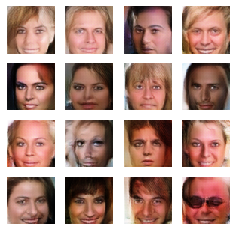

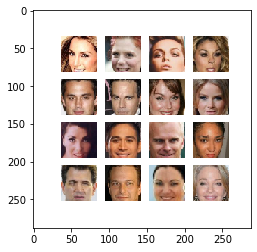

Time for epoch 29 is 211.19905185699463 sec
Gen_loss:  1.06454492 Disc_loss:  1.06766415
Gen_loss:  1.06945777 Disc_loss:  1.11385357
Gen_loss:  1.4259975 Disc_loss:  1.1904552
Gen_loss:  1.175843 Disc_loss:  1.09804654
Gen_loss:  1.27053833 Disc_loss:  1.11351585
Gen_loss:  1.14006793 Disc_loss:  1.14203238
Gen_loss:  1.42240191 Disc_loss:  1.01315963
Gen_loss:  1.01593673 Disc_loss:  1.04840541
Gen_loss:  1.20654011 Disc_loss:  1.09131217
Gen_loss:  1.03091908 Disc_loss:  1.07439315
Gen_loss:  1.09882414 Disc_loss:  1.16530621
Gen_loss:  1.10866964 Disc_loss:  1.14537823
Gen_loss:  1.19332445 Disc_loss:  1.13537383
Gen_loss:  1.15299666 Disc_loss:  1.06857157
generate_and_save_images


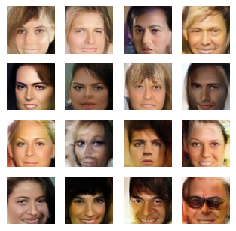

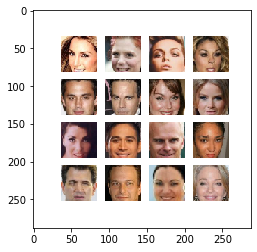

Time for epoch 30 is 211.81039381027222 sec
Gen_loss:  1.0774014 Disc_loss:  1.13913918
Gen_loss:  1.39483786 Disc_loss:  1.2428844
Gen_loss:  1.10146439 Disc_loss:  1.0656656
Gen_loss:  1.19720209 Disc_loss:  1.18701
Gen_loss:  1.37164569 Disc_loss:  1.19698524
Gen_loss:  1.20835769 Disc_loss:  1.15471959
Gen_loss:  1.38630438 Disc_loss:  1.13115788
Gen_loss:  1.37631619 Disc_loss:  1.12683249
Gen_loss:  1.21584594 Disc_loss:  1.21251333
Gen_loss:  1.19492006 Disc_loss:  1.17158723
Gen_loss:  1.31056726 Disc_loss:  1.12788844
Gen_loss:  1.18749988 Disc_loss:  1.06839919
Gen_loss:  1.10099602 Disc_loss:  1.16885209
Gen_loss:  1.25253952 Disc_loss:  1.04827428
generate_and_save_images


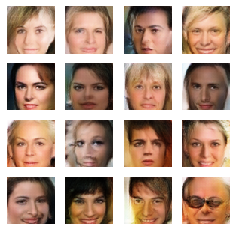

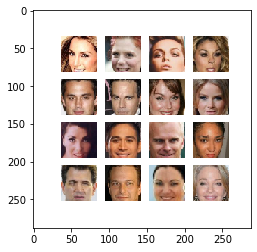

Time for epoch 31 is 211.22194743156433 sec
Gen_loss:  1.44986522 Disc_loss:  1.44004416
Gen_loss:  1.19128 Disc_loss:  1.18312502
Gen_loss:  1.28600621 Disc_loss:  1.07874227
Gen_loss:  1.06364918 Disc_loss:  1.1325177
Gen_loss:  1.11442447 Disc_loss:  1.13473225
Gen_loss:  1.40258062 Disc_loss:  1.34329402
Gen_loss:  1.02734518 Disc_loss:  1.10612762
Gen_loss:  1.23080373 Disc_loss:  1.07605267
Gen_loss:  1.26588368 Disc_loss:  1.0867
Gen_loss:  1.03216028 Disc_loss:  1.13713348
Gen_loss:  1.36220837 Disc_loss:  1.30718
Gen_loss:  1.17993331 Disc_loss:  1.20525265
Gen_loss:  1.06312859 Disc_loss:  1.13447583
generate_and_save_images


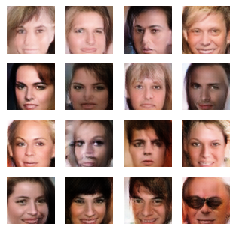

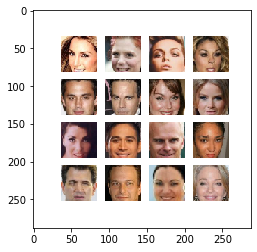

Time for epoch 32 is 211.85778880119324 sec
Gen_loss:  1.83605385 Disc_loss:  1.35208225
Gen_loss:  1.26131892 Disc_loss:  1.08871508
Gen_loss:  1.33016014 Disc_loss:  1.03476632
Gen_loss:  1.1518656 Disc_loss:  1.1219008
Gen_loss:  1.63592517 Disc_loss:  1.48597085
Gen_loss:  0.954081059 Disc_loss:  1.10493565
Gen_loss:  0.949254155 Disc_loss:  1.154778
Gen_loss:  1.85310841 Disc_loss:  1.5737406
Gen_loss:  1.35151255 Disc_loss:  1.05139482
Gen_loss:  1.25892282 Disc_loss:  1.15641928
Gen_loss:  1.24692738 Disc_loss:  1.06068742
Gen_loss:  1.22563243 Disc_loss:  1.21973693
Gen_loss:  1.12377238 Disc_loss:  1.07084405
Gen_loss:  1.2381506 Disc_loss:  1.04962683
generate_and_save_images


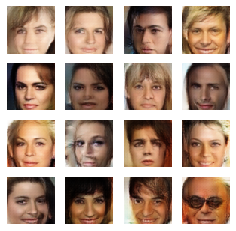

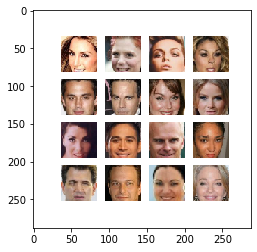

Time for epoch 33 is 216.74171662330627 sec
Gen_loss:  1.31716812 Disc_loss:  1.14130414
Gen_loss:  1.2616663 Disc_loss:  1.09835184
Gen_loss:  1.18006396 Disc_loss:  1.09182513
Gen_loss:  1.05893099 Disc_loss:  1.07375097
Gen_loss:  1.133515 Disc_loss:  1.12551332
Gen_loss:  1.13821232 Disc_loss:  1.19436264
Gen_loss:  1.21177292 Disc_loss:  1.13954687
Gen_loss:  1.50638616 Disc_loss:  1.10569131
Gen_loss:  1.36910439 Disc_loss:  1.0910542
Gen_loss:  1.25464833 Disc_loss:  1.10693121
Gen_loss:  1.44530582 Disc_loss:  1.11845803
Gen_loss:  1.17173326 Disc_loss:  1.04239953
Gen_loss:  1.12738407 Disc_loss:  1.0899744
Gen_loss:  0.948209 Disc_loss:  1.18847656
generate_and_save_images


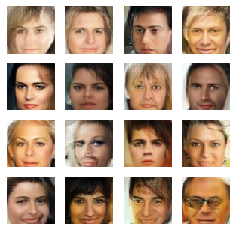

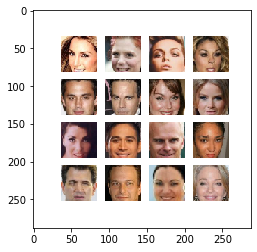

Time for epoch 34 is 217.9074957370758 sec
Gen_loss:  0.98846662 Disc_loss:  1.08640671
Gen_loss:  1.11288869 Disc_loss:  1.10738873
Gen_loss:  1.10429585 Disc_loss:  1.05409932
Gen_loss:  1.16357946 Disc_loss:  1.1280067
Gen_loss:  1.25370944 Disc_loss:  1.09981966
Gen_loss:  0.970785201 Disc_loss:  1.1107018
Gen_loss:  1.33315492 Disc_loss:  1.14113319
Gen_loss:  1.14184403 Disc_loss:  1.16100359
Gen_loss:  1.45513988 Disc_loss:  1.28218222
Gen_loss:  0.993193865 Disc_loss:  1.03467858
Gen_loss:  1.13582182 Disc_loss:  1.12470984
Gen_loss:  1.10164654 Disc_loss:  1.12736583
Gen_loss:  1.74424493 Disc_loss:  1.32407832
Gen_loss:  1.0546149 Disc_loss:  1.03626895
generate_and_save_images


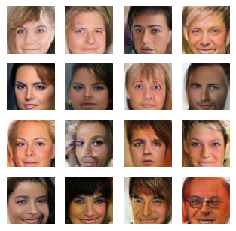

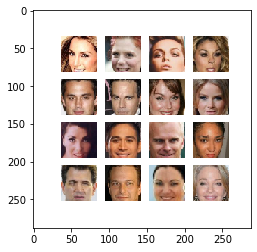

Time for epoch 35 is 218.8252944946289 sec
Gen_loss:  1.02749968 Disc_loss:  1.13925433
Gen_loss:  1.27405214 Disc_loss:  1.11470723
Gen_loss:  1.10037518 Disc_loss:  1.10925257
Gen_loss:  1.09793651 Disc_loss:  1.10238051
Gen_loss:  1.15057337 Disc_loss:  1.05740857
Gen_loss:  0.959055841 Disc_loss:  1.15496
Gen_loss:  1.18353689 Disc_loss:  1.13655162
Gen_loss:  1.2686801 Disc_loss:  1.06926107
Gen_loss:  1.14269948 Disc_loss:  1.13782167
Gen_loss:  1.05552852 Disc_loss:  1.09941876
Gen_loss:  1.14032531 Disc_loss:  1.20294499
Gen_loss:  1.09774661 Disc_loss:  1.08270526
Gen_loss:  1.27198386 Disc_loss:  1.13012922
Gen_loss:  1.38300514 Disc_loss:  1.44984
generate_and_save_images


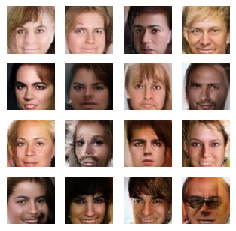

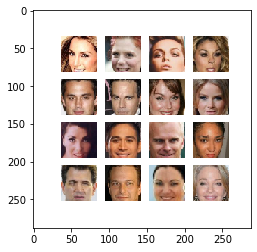

Time for epoch 36 is 218.7057340145111 sec
Gen_loss:  1.22007442 Disc_loss:  1.22529912
Gen_loss:  1.25138497 Disc_loss:  1.18079352
Gen_loss:  1.11733234 Disc_loss:  1.14998925
Gen_loss:  1.17744446 Disc_loss:  1.12350798
Gen_loss:  1.32623041 Disc_loss:  1.02313161
Gen_loss:  1.10457468 Disc_loss:  1.09429717
Gen_loss:  1.24648094 Disc_loss:  1.25254786
Gen_loss:  1.0722034 Disc_loss:  1.0353843
Gen_loss:  1.18637669 Disc_loss:  1.17031
Gen_loss:  1.32459748 Disc_loss:  1.1356529
Gen_loss:  1.43936646 Disc_loss:  1.0189631
Gen_loss:  1.41392756 Disc_loss:  1.25550747
Gen_loss:  1.1617806 Disc_loss:  1.04365838
generate_and_save_images


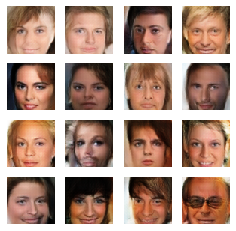

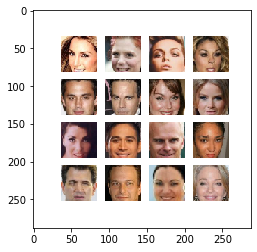

Time for epoch 37 is 219.00732111930847 sec
Gen_loss:  1.40712178 Disc_loss:  1.36961555
Gen_loss:  1.06126058 Disc_loss:  1.07460093
Gen_loss:  0.93225342 Disc_loss:  1.18496883
Gen_loss:  1.19608378 Disc_loss:  1.02642059
Gen_loss:  1.87968755 Disc_loss:  1.32149637
Gen_loss:  1.01892149 Disc_loss:  1.15643454
Gen_loss:  1.08680809 Disc_loss:  1.07614779
Gen_loss:  1.40204954 Disc_loss:  1.02705193
Gen_loss:  1.35195577 Disc_loss:  1.15377724
Gen_loss:  1.43471825 Disc_loss:  1.14041209
Gen_loss:  1.40353036 Disc_loss:  1.13980389
Gen_loss:  1.25568295 Disc_loss:  1.13224053
Gen_loss:  1.18345857 Disc_loss:  1.17417014
Gen_loss:  1.28550887 Disc_loss:  1.06484652
generate_and_save_images


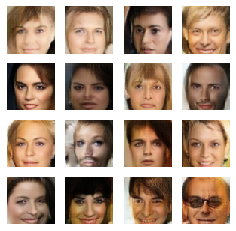

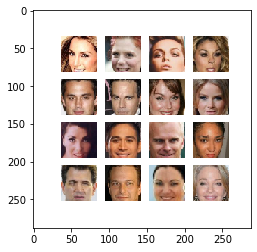

Time for epoch 38 is 218.31880593299866 sec
Gen_loss:  1.82587993 Disc_loss:  1.65317512
Gen_loss:  1.40255439 Disc_loss:  1.01136076
Gen_loss:  1.51626599 Disc_loss:  1.36420858
Gen_loss:  1.01676488 Disc_loss:  1.04342461
Gen_loss:  1.38280272 Disc_loss:  1.04347944
Gen_loss:  1.37080765 Disc_loss:  1.22499371
Gen_loss:  1.03030193 Disc_loss:  1.09865701
Gen_loss:  1.16122627 Disc_loss:  1.1199584
Gen_loss:  1.6498487 Disc_loss:  1.20969772
Gen_loss:  1.13060904 Disc_loss:  1.05953646
Gen_loss:  1.45980692 Disc_loss:  1.36912346
Gen_loss:  1.41817677 Disc_loss:  1.08143854
Gen_loss:  1.06807888 Disc_loss:  1.15714657
Gen_loss:  1.10763025 Disc_loss:  1.07317686
generate_and_save_images


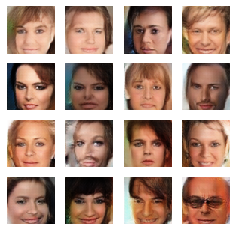

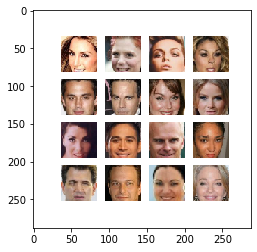

Time for epoch 39 is 216.11708807945251 sec
Gen_loss:  1.25480354 Disc_loss:  1.3264842
Gen_loss:  1.27295184 Disc_loss:  1.05331135
Gen_loss:  1.1642772 Disc_loss:  1.00634336
Gen_loss:  1.1402092 Disc_loss:  1.02155507
Gen_loss:  1.51540947 Disc_loss:  1.07501054
Gen_loss:  1.52869868 Disc_loss:  1.29225922
Gen_loss:  1.47258675 Disc_loss:  1.08251381
Gen_loss:  1.18053222 Disc_loss:  1.11650324
Gen_loss:  1.40543282 Disc_loss:  1.06767094
Gen_loss:  1.84085846 Disc_loss:  1.45757413
Gen_loss:  1.24387085 Disc_loss:  1.20825469
Gen_loss:  1.54770732 Disc_loss:  1.20241666
Gen_loss:  1.20062566 Disc_loss:  1.12360787
Gen_loss:  1.30498636 Disc_loss:  1.12320673
generate_and_save_images


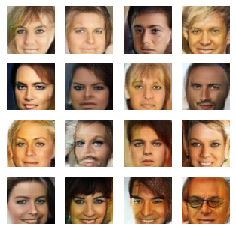

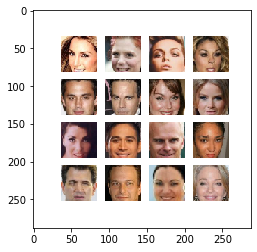

Time for epoch 40 is 215.75023913383484 sec
Gen_loss:  1.35282099 Disc_loss:  0.987259388
Gen_loss:  1.27111411 Disc_loss:  1.10126913
Gen_loss:  1.16820467 Disc_loss:  1.20503
Gen_loss:  1.07613111 Disc_loss:  1.1012125
Gen_loss:  1.31809402 Disc_loss:  1.01232731
Gen_loss:  1.24133039 Disc_loss:  1.11691761
Gen_loss:  1.35217059 Disc_loss:  1.15066421
Gen_loss:  1.2918334 Disc_loss:  0.952276587
Gen_loss:  1.22475374 Disc_loss:  1.03435254
Gen_loss:  1.20410192 Disc_loss:  1.13098061
Gen_loss:  1.55338717 Disc_loss:  1.22759008
Gen_loss:  1.35080945 Disc_loss:  0.92467761
Gen_loss:  1.29260504 Disc_loss:  1.11391616
generate_and_save_images


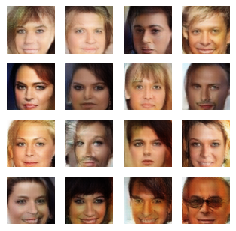

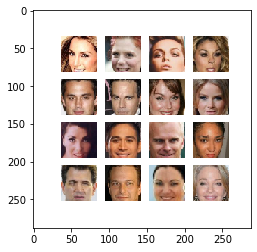

Time for epoch 41 is 215.43560075759888 sec
Gen_loss:  1.16916 Disc_loss:  1.12355232
Gen_loss:  1.22007322 Disc_loss:  0.992347658
Gen_loss:  1.16088724 Disc_loss:  1.00343013
Gen_loss:  1.2783941 Disc_loss:  0.997089386
Gen_loss:  0.7933442 Disc_loss:  1.22300982
Gen_loss:  1.38710666 Disc_loss:  1.06278491
Gen_loss:  0.992551565 Disc_loss:  1.07233405
Gen_loss:  0.960757852 Disc_loss:  1.09151
Gen_loss:  1.42848039 Disc_loss:  1.22234261
Gen_loss:  1.11027288 Disc_loss:  1.07936096
Gen_loss:  1.45636773 Disc_loss:  1.25307226
Gen_loss:  1.14709604 Disc_loss:  1.12611485
Gen_loss:  1.00694644 Disc_loss:  1.10486436
Gen_loss:  1.20375681 Disc_loss:  1.15513325
generate_and_save_images


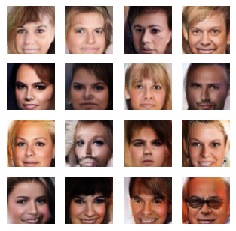

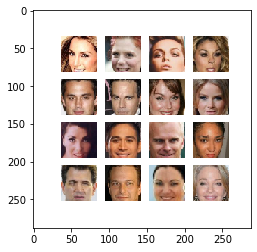

Time for epoch 42 is 217.07855248451233 sec
Gen_loss:  1.11901891 Disc_loss:  1.11469197
Gen_loss:  1.13651633 Disc_loss:  1.18810916
Gen_loss:  1.32255054 Disc_loss:  1.18123722
Gen_loss:  0.793202519 Disc_loss:  1.23553705
Gen_loss:  1.16210926 Disc_loss:  1.04487967
Gen_loss:  1.33296812 Disc_loss:  1.05224848
Gen_loss:  1.08976817 Disc_loss:  1.10464621
Gen_loss:  1.17867827 Disc_loss:  1.12968326
Gen_loss:  1.33435023 Disc_loss:  1.06967
Gen_loss:  1.05532348 Disc_loss:  1.10986018
Gen_loss:  1.20017898 Disc_loss:  1.07919061
Gen_loss:  1.21261883 Disc_loss:  1.00315642
Gen_loss:  1.22077382 Disc_loss:  1.21927118
Gen_loss:  1.10530162 Disc_loss:  1.05364561
generate_and_save_images


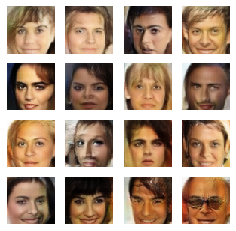

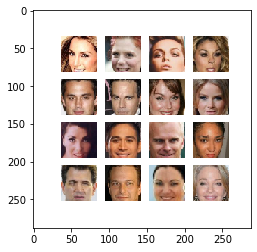

Time for epoch 43 is 219.67741227149963 sec
Gen_loss:  1.3290503 Disc_loss:  1.04528892
Gen_loss:  1.16963601 Disc_loss:  1.04607415
Gen_loss:  1.29188108 Disc_loss:  1.03379869
Gen_loss:  1.00545943 Disc_loss:  1.10267448
Gen_loss:  1.13789368 Disc_loss:  1.00612283
Gen_loss:  1.28486931 Disc_loss:  1.28350735
Gen_loss:  1.47517812 Disc_loss:  1.20102084
Gen_loss:  1.506428 Disc_loss:  1.18243468
Gen_loss:  0.968608677 Disc_loss:  1.19030952
Gen_loss:  1.51793253 Disc_loss:  1.19155121
Gen_loss:  1.28433836 Disc_loss:  1.24673069
Gen_loss:  1.37967157 Disc_loss:  1.09801078
Gen_loss:  1.18238258 Disc_loss:  1.15695572
Gen_loss:  1.31527269 Disc_loss:  1.16908264
generate_and_save_images


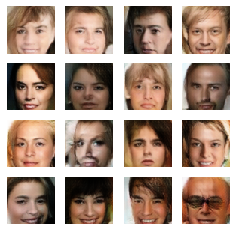

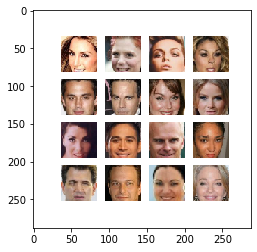

Time for epoch 44 is 217.77536964416504 sec
Gen_loss:  1.09944117 Disc_loss:  1.12758625
Gen_loss:  1.381917 Disc_loss:  1.1428864
Gen_loss:  1.11861527 Disc_loss:  1.13401222
Gen_loss:  1.18807971 Disc_loss:  1.08941817
Gen_loss:  1.16683638 Disc_loss:  1.10420942
Gen_loss:  1.25581837 Disc_loss:  1.01988542
Gen_loss:  1.18062365 Disc_loss:  1.10239232
Gen_loss:  1.5114665 Disc_loss:  1.17974615
Gen_loss:  1.48343682 Disc_loss:  1.27570915
Gen_loss:  1.15295458 Disc_loss:  1.13200331
Gen_loss:  1.26158082 Disc_loss:  1.08684659
Gen_loss:  1.24950683 Disc_loss:  1.12242365
Gen_loss:  1.17020321 Disc_loss:  1.03895211
Gen_loss:  1.50513482 Disc_loss:  1.0420661
generate_and_save_images


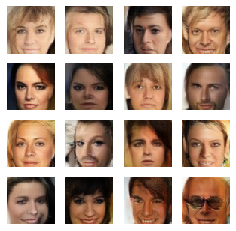

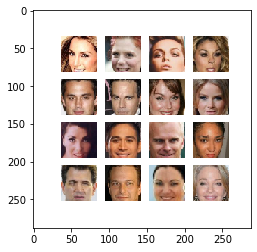

Time for epoch 45 is 218.40827202796936 sec
Gen_loss:  1.62190831 Disc_loss:  1.05868554
Gen_loss:  1.08502114 Disc_loss:  1.10514736
Gen_loss:  1.18037438 Disc_loss:  1.16632581
Gen_loss:  1.15787828 Disc_loss:  1.14045727
Gen_loss:  1.44686055 Disc_loss:  1.27411199
Gen_loss:  1.07354152 Disc_loss:  1.06093812
Gen_loss:  1.09381032 Disc_loss:  1.03169513
Gen_loss:  1.25897503 Disc_loss:  1.16374731
Gen_loss:  1.29991174 Disc_loss:  1.09783566
Gen_loss:  1.41946888 Disc_loss:  1.20853484
Gen_loss:  1.30387223 Disc_loss:  1.03766787
Gen_loss:  1.33584452 Disc_loss:  1.14539635
Gen_loss:  1.298087 Disc_loss:  1.10684657
generate_and_save_images


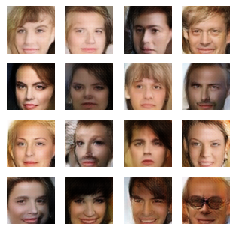

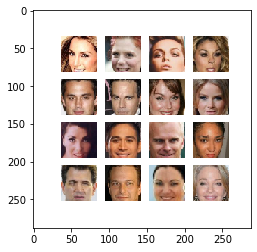

Time for epoch 46 is 218.67902421951294 sec
Gen_loss:  1.5308696 Disc_loss:  1.40777814
Gen_loss:  1.31314898 Disc_loss:  1.06810737
Gen_loss:  1.26594949 Disc_loss:  1.05730224
Gen_loss:  1.16489363 Disc_loss:  1.13058019
Gen_loss:  1.53870142 Disc_loss:  1.17620027
Gen_loss:  1.11556268 Disc_loss:  1.13853574
Gen_loss:  1.14351869 Disc_loss:  1.15412843
Gen_loss:  1.13772869 Disc_loss:  1.04841065
Gen_loss:  1.35562897 Disc_loss:  1.14536762
Gen_loss:  1.21274519 Disc_loss:  1.24881601
Gen_loss:  1.12044394 Disc_loss:  1.0849328
Gen_loss:  1.10281897 Disc_loss:  1.06497538
Gen_loss:  1.2299453 Disc_loss:  1.08021188
Gen_loss:  1.68778801 Disc_loss:  1.16669667
generate_and_save_images


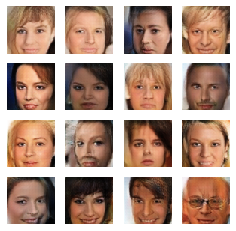

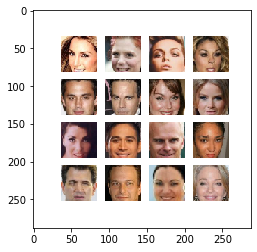

Time for epoch 47 is 218.54592490196228 sec
Gen_loss:  1.1278913 Disc_loss:  1.12076271
Gen_loss:  1.4990114 Disc_loss:  1.09124362
Gen_loss:  1.17076588 Disc_loss:  1.09729826
Gen_loss:  1.20480049 Disc_loss:  1.15433359
Gen_loss:  1.11455655 Disc_loss:  1.03332388
Gen_loss:  1.25853848 Disc_loss:  1.1560204
Gen_loss:  1.05668259 Disc_loss:  1.00811052
Gen_loss:  1.17072606 Disc_loss:  0.989839196
Gen_loss:  1.1214366 Disc_loss:  1.03008473
Gen_loss:  1.31891298 Disc_loss:  1.05219352
Gen_loss:  1.19990695 Disc_loss:  0.980453193
Gen_loss:  1.03505719 Disc_loss:  1.11585546
Gen_loss:  1.26250708 Disc_loss:  1.14021862
Gen_loss:  1.25086975 Disc_loss:  1.12438035
generate_and_save_images


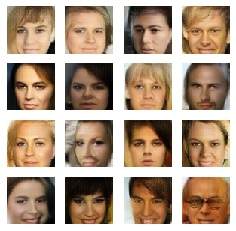

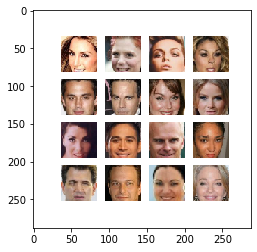

Time for epoch 48 is 215.23730516433716 sec
Gen_loss:  1.21293461 Disc_loss:  1.1416049
Gen_loss:  1.29727483 Disc_loss:  1.10350335
Gen_loss:  1.4282515 Disc_loss:  1.11037326
Gen_loss:  1.47984242 Disc_loss:  1.17404151
Gen_loss:  1.93528879 Disc_loss:  1.52433157
Gen_loss:  1.30676472 Disc_loss:  1.05702245
Gen_loss:  1.16515899 Disc_loss:  1.25246787
Gen_loss:  1.12369776 Disc_loss:  1.07580924
Gen_loss:  1.31426287 Disc_loss:  1.09492874
Gen_loss:  1.23032165 Disc_loss:  1.03624868
Gen_loss:  1.11089098 Disc_loss:  1.05856335
Gen_loss:  1.3012929 Disc_loss:  1.19449544
Gen_loss:  1.37015307 Disc_loss:  1.12275243
Gen_loss:  1.34302247 Disc_loss:  1.23420858
generate_and_save_images


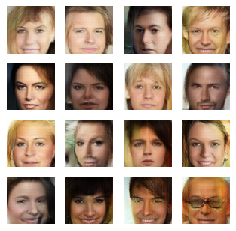

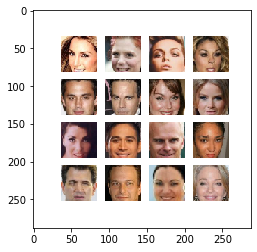

Time for epoch 49 is 214.4298963546753 sec
Gen_loss:  1.11608136 Disc_loss:  1.14078307
Gen_loss:  1.13103569 Disc_loss:  1.06583238
Gen_loss:  1.03317809 Disc_loss:  1.08050728
Gen_loss:  1.08885121 Disc_loss:  1.10338163
Gen_loss:  1.05192637 Disc_loss:  1.16684473
Gen_loss:  1.19323075 Disc_loss:  1.16224349
Gen_loss:  1.28337348 Disc_loss:  1.03650177
Gen_loss:  1.22393107 Disc_loss:  1.1342777
Gen_loss:  1.20374489 Disc_loss:  1.25466347
Gen_loss:  1.17463136 Disc_loss:  1.02312684
Gen_loss:  0.927622199 Disc_loss:  1.1145705
Gen_loss:  1.22810078 Disc_loss:  1.13278544
Gen_loss:  1.19743776 Disc_loss:  1.08940578
Gen_loss:  1.16376305 Disc_loss:  1.15038848
generate_and_save_images


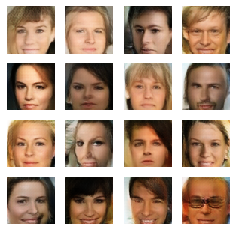

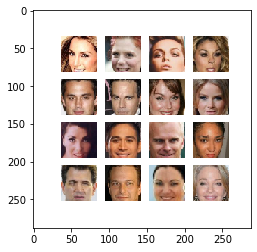

Time for epoch 50 is 212.24060487747192 sec
Gen_loss:  1.22349024 Disc_loss:  1.00156844
Gen_loss:  1.07250834 Disc_loss:  1.07596028
Gen_loss:  1.31208539 Disc_loss:  1.15506506
Gen_loss:  1.16521895 Disc_loss:  1.14803433
Gen_loss:  1.13748312 Disc_loss:  1.07482636
Gen_loss:  1.48389435 Disc_loss:  1.22456503
Gen_loss:  1.2722888 Disc_loss:  0.977500319
Gen_loss:  1.39106572 Disc_loss:  1.19585013
Gen_loss:  1.30307424 Disc_loss:  1.09528732
Gen_loss:  1.10171151 Disc_loss:  1.12554693
Gen_loss:  1.18077683 Disc_loss:  1.00037563
Gen_loss:  1.46102691 Disc_loss:  1.31849194
Gen_loss:  1.60665727 Disc_loss:  1.16960859
generate_and_save_images


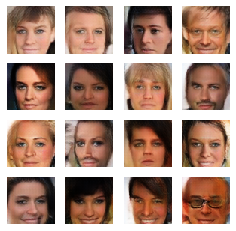

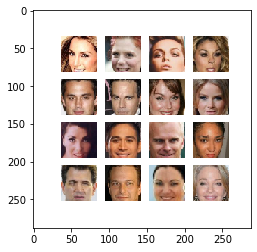

Time for epoch 51 is 211.5826907157898 sec
Gen_loss:  1.41715801 Disc_loss:  1.12253678
Gen_loss:  1.29272842 Disc_loss:  1.12327194
Gen_loss:  1.53652835 Disc_loss:  1.17284203
Gen_loss:  1.15887094 Disc_loss:  1.08528841
Gen_loss:  1.3719784 Disc_loss:  0.987905741
Gen_loss:  1.3889122 Disc_loss:  1.21624947
Gen_loss:  1.19989288 Disc_loss:  1.199525
Gen_loss:  1.18845201 Disc_loss:  1.07801795
Gen_loss:  1.12914467 Disc_loss:  0.999348044
Gen_loss:  1.27368319 Disc_loss:  1.0513736
Gen_loss:  1.00292611 Disc_loss:  1.09334683
Gen_loss:  1.17073059 Disc_loss:  1.1138587
Gen_loss:  1.42673111 Disc_loss:  1.1514647
Gen_loss:  1.38121915 Disc_loss:  1.11223686
generate_and_save_images


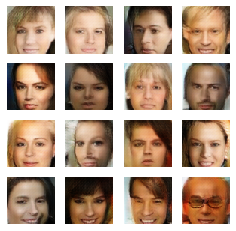

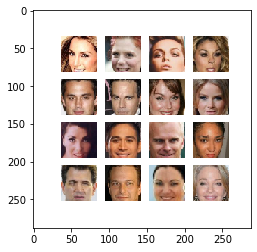

Time for epoch 52 is 211.56064414978027 sec
Gen_loss:  1.08874238 Disc_loss:  1.12681627
Gen_loss:  1.14338517 Disc_loss:  1.08420682
Gen_loss:  1.18447185 Disc_loss:  1.17706978
Gen_loss:  1.15401137 Disc_loss:  1.09603572
Gen_loss:  1.18195152 Disc_loss:  1.12900829
Gen_loss:  1.26574659 Disc_loss:  1.17132235
Gen_loss:  1.55041289 Disc_loss:  1.31782103
Gen_loss:  1.64037323 Disc_loss:  1.12587416
Gen_loss:  1.13012886 Disc_loss:  0.989635348
Gen_loss:  1.41951227 Disc_loss:  1.10552835
Gen_loss:  1.09644055 Disc_loss:  1.16777694
Gen_loss:  1.5551089 Disc_loss:  1.25416505
Gen_loss:  1.36854839 Disc_loss:  1.27527475
Gen_loss:  1.22962403 Disc_loss:  1.04866946
generate_and_save_images


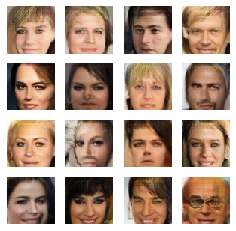

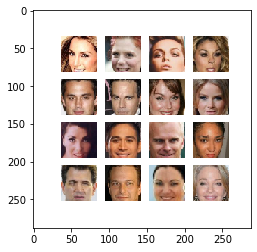

Time for epoch 53 is 210.471421957016 sec
Gen_loss:  1.20647645 Disc_loss:  1.05542207
Gen_loss:  1.18771541 Disc_loss:  1.03257418
Gen_loss:  1.16020489 Disc_loss:  1.0457989
Gen_loss:  1.41530037 Disc_loss:  0.987124205
Gen_loss:  1.0682056 Disc_loss:  1.06733143
Gen_loss:  1.1613028 Disc_loss:  1.09330082
Gen_loss:  1.38001263 Disc_loss:  1.14028621
Gen_loss:  1.20833635 Disc_loss:  1.06220365
Gen_loss:  1.17603493 Disc_loss:  1.06954813
Gen_loss:  1.80701792 Disc_loss:  1.15727139
Gen_loss:  1.13344228 Disc_loss:  1.12890613
Gen_loss:  1.42513227 Disc_loss:  1.12552142
Gen_loss:  1.25305843 Disc_loss:  1.18315506
Gen_loss:  1.13140559 Disc_loss:  1.06584215
generate_and_save_images


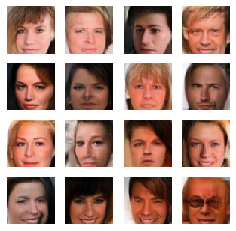

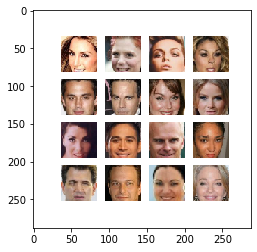

Time for epoch 54 is 211.49102354049683 sec
Gen_loss:  1.79320717 Disc_loss:  1.30161011
Gen_loss:  1.25479424 Disc_loss:  1.12544668
Gen_loss:  1.64582598 Disc_loss:  1.41525853
Gen_loss:  1.19523203 Disc_loss:  0.994357944
Gen_loss:  1.16458011 Disc_loss:  1.11510253
Gen_loss:  0.992677629 Disc_loss:  1.05596876
Gen_loss:  0.991682768 Disc_loss:  1.14939868
Gen_loss:  1.26011932 Disc_loss:  1.15929341
Gen_loss:  1.23058116 Disc_loss:  1.08821273
Gen_loss:  1.09220147 Disc_loss:  0.975166559
Gen_loss:  1.12356353 Disc_loss:  1.06896186
Gen_loss:  1.10682583 Disc_loss:  1.09658456
Gen_loss:  1.45024979 Disc_loss:  1.11070514
generate_and_save_images


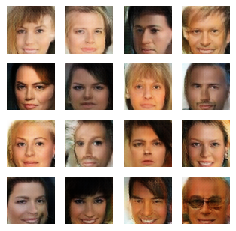

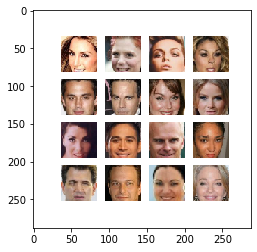

Time for epoch 55 is 211.60123491287231 sec
Gen_loss:  2.0311203 Disc_loss:  1.36330199
Gen_loss:  1.25349212 Disc_loss:  1.22940624
Gen_loss:  1.1135447 Disc_loss:  1.00567818
Gen_loss:  1.4086113 Disc_loss:  0.941922367
Gen_loss:  1.15455174 Disc_loss:  1.09388876
Gen_loss:  1.20903301 Disc_loss:  1.05730367
Gen_loss:  1.21290207 Disc_loss:  1.06795311
Gen_loss:  1.20865142 Disc_loss:  1.00582647
Gen_loss:  1.11314499 Disc_loss:  1.11204958
Gen_loss:  1.30561829 Disc_loss:  1.12921607
Gen_loss:  1.51289415 Disc_loss:  1.15500021
Gen_loss:  1.24599349 Disc_loss:  1.01445532
Gen_loss:  1.16316688 Disc_loss:  1.08815658
Gen_loss:  1.05245662 Disc_loss:  1.1754353
generate_and_save_images


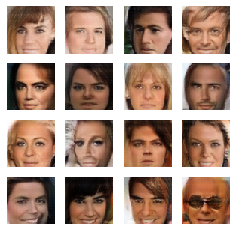

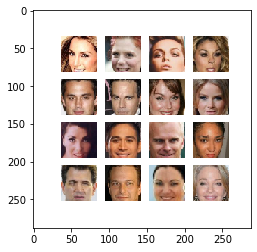

Time for epoch 56 is 211.0658049583435 sec
Gen_loss:  1.41756511 Disc_loss:  1.46116173
Gen_loss:  0.932871103 Disc_loss:  1.08542061
Gen_loss:  1.10500908 Disc_loss:  1.13344669
Gen_loss:  1.35697722 Disc_loss:  1.18560982
Gen_loss:  1.20306337 Disc_loss:  1.1085794
Gen_loss:  1.2398597 Disc_loss:  1.13073874
Gen_loss:  1.27307773 Disc_loss:  1.14353228
Gen_loss:  1.15771711 Disc_loss:  1.16625214
Gen_loss:  1.51760292 Disc_loss:  1.038643
Gen_loss:  1.43545794 Disc_loss:  1.23356223
Gen_loss:  1.32519722 Disc_loss:  1.14655066
Gen_loss:  1.79417419 Disc_loss:  1.27514172
Gen_loss:  1.13154042 Disc_loss:  1.05625618
Gen_loss:  1.21259379 Disc_loss:  1.08947349
generate_and_save_images


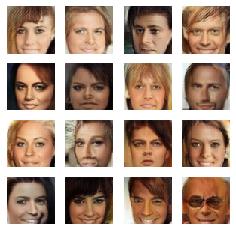

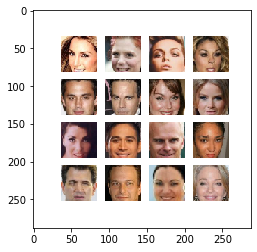

Time for epoch 57 is 210.48576641082764 sec
Gen_loss:  1.21276343 Disc_loss:  1.05041909
Gen_loss:  1.14845097 Disc_loss:  1.08451474
Gen_loss:  1.26396585 Disc_loss:  1.09920144
Gen_loss:  1.69276559 Disc_loss:  1.18610227
Gen_loss:  1.47399843 Disc_loss:  1.04563785
Gen_loss:  1.62237346 Disc_loss:  1.28179646
Gen_loss:  1.26918733 Disc_loss:  1.25609255
Gen_loss:  1.36029065 Disc_loss:  1.01924849
Gen_loss:  0.867490053 Disc_loss:  1.19389009
Gen_loss:  1.09232104 Disc_loss:  1.01865792
Gen_loss:  1.25340509 Disc_loss:  1.20235372
Gen_loss:  1.63827729 Disc_loss:  1.56816649
Gen_loss:  1.17698383 Disc_loss:  1.09336376
Gen_loss:  0.92713064 Disc_loss:  1.11069655
generate_and_save_images


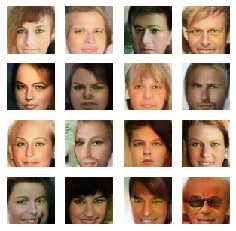

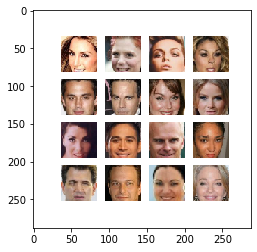

Time for epoch 58 is 210.97432160377502 sec
Gen_loss:  1.31191695 Disc_loss:  1.03398895
Gen_loss:  1.24096072 Disc_loss:  1.03400707
Gen_loss:  1.37754381 Disc_loss:  1.17919791
Gen_loss:  1.09074771 Disc_loss:  1.13129711
Gen_loss:  1.32750726 Disc_loss:  1.1530571
Gen_loss:  1.23825955 Disc_loss:  0.978926539
Gen_loss:  1.30335867 Disc_loss:  1.17010212
Gen_loss:  1.3989898 Disc_loss:  1.27599025
Gen_loss:  1.28261042 Disc_loss:  1.18162441
Gen_loss:  1.22650373 Disc_loss:  1.20517659
Gen_loss:  1.48334861 Disc_loss:  1.04323542
Gen_loss:  1.2981602 Disc_loss:  1.13405502
Gen_loss:  1.06216872 Disc_loss:  1.11695147
Gen_loss:  1.24665201 Disc_loss:  0.986013472
generate_and_save_images


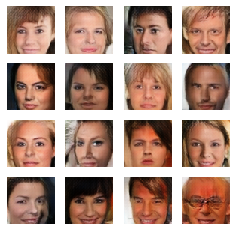

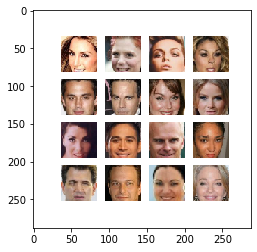

Time for epoch 59 is 213.30434823036194 sec
Gen_loss:  1.26942921 Disc_loss:  1.0544703
Gen_loss:  1.30643094 Disc_loss:  1.1044085
Gen_loss:  1.19942451 Disc_loss:  1.21198106
Gen_loss:  1.64236164 Disc_loss:  1.48832703
Gen_loss:  1.43230724 Disc_loss:  1.03675938
Gen_loss:  1.240448 Disc_loss:  1.15739143
Gen_loss:  1.17866981 Disc_loss:  1.1898787
Gen_loss:  1.28168976 Disc_loss:  1.08667731
Gen_loss:  1.21743548 Disc_loss:  1.09174037
Gen_loss:  1.31930482 Disc_loss:  1.10853589
Gen_loss:  1.29208791 Disc_loss:  1.08335185
Gen_loss:  1.06028175 Disc_loss:  1.13066256
Gen_loss:  1.21779084 Disc_loss:  1.18409121
generate_and_save_images


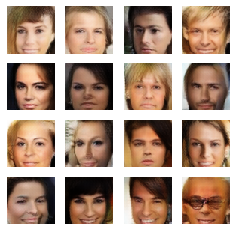

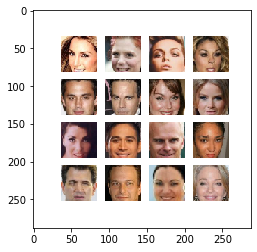

Time for epoch 60 is 213.45838928222656 sec
Gen_loss:  1.2139765 Disc_loss:  1.21781111
Gen_loss:  1.31508732 Disc_loss:  1.27102494
Gen_loss:  1.2270546 Disc_loss:  1.0644536
Gen_loss:  1.50055063 Disc_loss:  1.21408701
Gen_loss:  1.10417843 Disc_loss:  1.05427635
Gen_loss:  1.59798825 Disc_loss:  1.11287796
Gen_loss:  1.22770524 Disc_loss:  1.18715787
Gen_loss:  1.61067557 Disc_loss:  1.12415493
Gen_loss:  1.04411805 Disc_loss:  1.03514242
Gen_loss:  1.50091612 Disc_loss:  1.30699158
Gen_loss:  1.07593942 Disc_loss:  1.15140188
Gen_loss:  1.57566786 Disc_loss:  1.09528804
Gen_loss:  1.34764695 Disc_loss:  1.20122755
Gen_loss:  1.2104131 Disc_loss:  1.12856936
generate_and_save_images


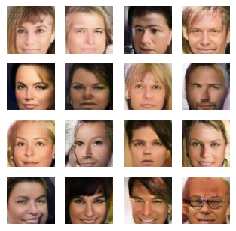

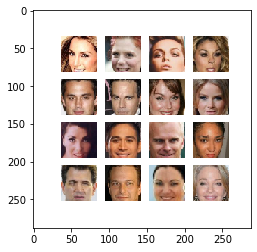

Time for epoch 61 is 212.31604552268982 sec
Gen_loss:  1.13434982 Disc_loss:  1.00449765
Gen_loss:  1.24924552 Disc_loss:  1.18782759
Gen_loss:  1.26927686 Disc_loss:  1.15058088
Gen_loss:  1.12821472 Disc_loss:  1.03863263
Gen_loss:  1.15717411 Disc_loss:  1.06917834
Gen_loss:  1.14726639 Disc_loss:  1.04518759
Gen_loss:  1.10232425 Disc_loss:  1.10271156
Gen_loss:  1.17318738 Disc_loss:  1.07056117
Gen_loss:  1.25418425 Disc_loss:  1.09142363
Gen_loss:  1.11207557 Disc_loss:  1.16540647
Gen_loss:  1.08222604 Disc_loss:  1.05353761
Gen_loss:  1.39717507 Disc_loss:  1.12471771
Gen_loss:  1.38994825 Disc_loss:  1.20422
Gen_loss:  1.16042578 Disc_loss:  1.1913501
generate_and_save_images


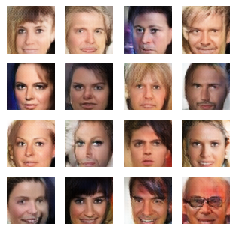

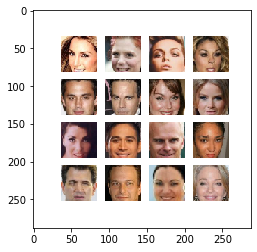

Time for epoch 62 is 212.61796855926514 sec
Gen_loss:  1.33151388 Disc_loss:  1.24462414
Gen_loss:  1.40611601 Disc_loss:  1.13028061
Gen_loss:  1.22635937 Disc_loss:  1.1631434
Gen_loss:  1.13015354 Disc_loss:  1.04414892
Gen_loss:  1.21834612 Disc_loss:  1.12444401
Gen_loss:  1.20473 Disc_loss:  1.02807546
Gen_loss:  1.43100429 Disc_loss:  1.16148567
Gen_loss:  1.27225697 Disc_loss:  1.12307811
Gen_loss:  1.39458156 Disc_loss:  1.05576682
Gen_loss:  1.49832392 Disc_loss:  1.11200261
Gen_loss:  1.21745467 Disc_loss:  1.15918279
Gen_loss:  1.21605992 Disc_loss:  1.18016243
Gen_loss:  1.32393217 Disc_loss:  1.20335269
Gen_loss:  1.36367381 Disc_loss:  1.01390314
generate_and_save_images


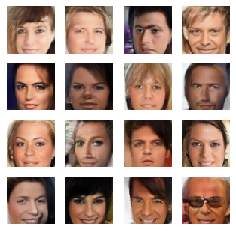

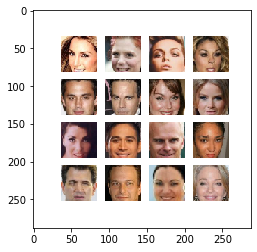

Time for epoch 63 is 211.40230536460876 sec
Gen_loss:  1.15473521 Disc_loss:  1.04261076
Gen_loss:  1.26127839 Disc_loss:  1.08020139
Gen_loss:  1.2159605 Disc_loss:  1.230057
Gen_loss:  1.22515202 Disc_loss:  1.00931036
Gen_loss:  1.53180575 Disc_loss:  1.01595902
Gen_loss:  1.36489677 Disc_loss:  1.04352868
Gen_loss:  1.14239454 Disc_loss:  0.970611513
Gen_loss:  1.16766572 Disc_loss:  1.09519243
Gen_loss:  1.34271336 Disc_loss:  1.01325
Gen_loss:  1.16993856 Disc_loss:  0.98858285
Gen_loss:  1.28326583 Disc_loss:  1.00597167
Gen_loss:  1.15672159 Disc_loss:  1.14486933
Gen_loss:  1.25000823 Disc_loss:  0.96191752
generate_and_save_images


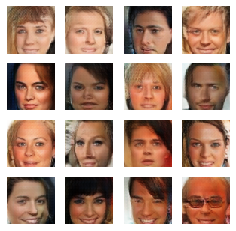

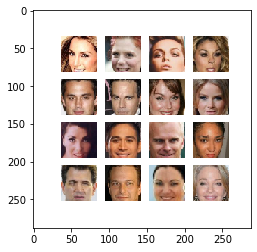

Time for epoch 64 is 212.22807574272156 sec
Gen_loss:  1.15096688 Disc_loss:  1.04817057
Gen_loss:  1.03218627 Disc_loss:  1.07449532
Gen_loss:  1.84596288 Disc_loss:  1.42655253
Gen_loss:  1.38599432 Disc_loss:  1.10928464
Gen_loss:  1.47020566 Disc_loss:  1.22190535
Gen_loss:  1.60024023 Disc_loss:  1.13971412
Gen_loss:  1.63444293 Disc_loss:  1.0899204
Gen_loss:  1.13943982 Disc_loss:  1.09711373
Gen_loss:  2.0169425 Disc_loss:  1.51058745
Gen_loss:  1.38409865 Disc_loss:  1.20142579
Gen_loss:  1.28822494 Disc_loss:  1.05093396
Gen_loss:  1.04420209 Disc_loss:  1.07020974
Gen_loss:  1.27866244 Disc_loss:  1.09048021
Gen_loss:  1.79382825 Disc_loss:  1.39485645
generate_and_save_images


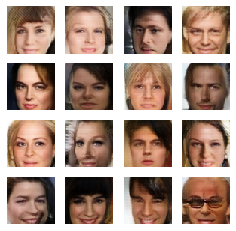

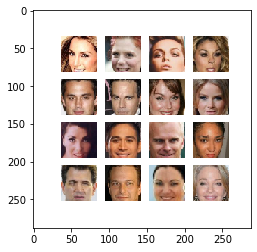

Time for epoch 65 is 211.79786849021912 sec
Gen_loss:  0.950523734 Disc_loss:  1.12564206
Gen_loss:  1.38282478 Disc_loss:  1.22916722
Gen_loss:  1.34364319 Disc_loss:  1.2190814
Gen_loss:  1.31918609 Disc_loss:  1.1895262
Gen_loss:  1.26383185 Disc_loss:  1.04100204
Gen_loss:  1.18455303 Disc_loss:  1.15285611
Gen_loss:  1.29695845 Disc_loss:  1.24429846
Gen_loss:  1.70297742 Disc_loss:  1.2441318
Gen_loss:  1.15700364 Disc_loss:  1.14458299
Gen_loss:  1.2766701 Disc_loss:  1.18836284
Gen_loss:  1.39161897 Disc_loss:  1.12847281
Gen_loss:  1.34914088 Disc_loss:  0.992647409
Gen_loss:  1.1974504 Disc_loss:  1.05130982
Gen_loss:  1.26649106 Disc_loss:  1.10296965
generate_and_save_images


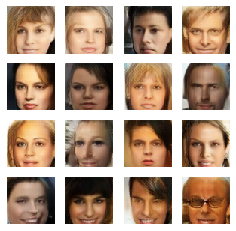

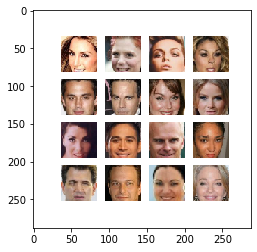

Time for epoch 66 is 212.5583245754242 sec
Gen_loss:  1.79339504 Disc_loss:  1.29307365
Gen_loss:  1.14436603 Disc_loss:  1.04258466
Gen_loss:  1.31138945 Disc_loss:  1.15307498
Gen_loss:  1.27943027 Disc_loss:  1.09120607
Gen_loss:  1.09567583 Disc_loss:  1.09108925
Gen_loss:  1.19109952 Disc_loss:  0.99333477
Gen_loss:  1.12811518 Disc_loss:  1.0444628
Gen_loss:  1.36698341 Disc_loss:  1.31142569
Gen_loss:  1.81355834 Disc_loss:  1.10397387
Gen_loss:  1.18614221 Disc_loss:  1.09841216
Gen_loss:  1.18286455 Disc_loss:  1.04857349
Gen_loss:  1.15993118 Disc_loss:  1.11764216
Gen_loss:  1.14945543 Disc_loss:  1.14878166
Gen_loss:  1.27353251 Disc_loss:  1.12281013
generate_and_save_images


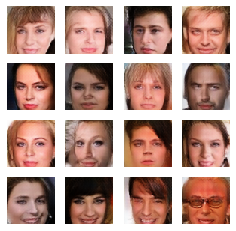

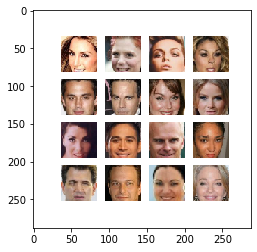

Time for epoch 67 is 211.6616668701172 sec
Gen_loss:  1.19794786 Disc_loss:  1.08919597
Gen_loss:  1.09368944 Disc_loss:  1.09947467
Gen_loss:  1.44230044 Disc_loss:  0.996261835
Gen_loss:  1.2836231 Disc_loss:  1.12794971
Gen_loss:  1.28605294 Disc_loss:  1.09837091
Gen_loss:  1.4383713 Disc_loss:  1.05651188
Gen_loss:  1.56376791 Disc_loss:  1.23564303
Gen_loss:  1.33479714 Disc_loss:  1.24122429
Gen_loss:  1.30394638 Disc_loss:  1.16690969
Gen_loss:  1.53319883 Disc_loss:  1.27196145
Gen_loss:  1.08316565 Disc_loss:  1.08010793
Gen_loss:  1.33928347 Disc_loss:  1.19328523
Gen_loss:  1.2305758 Disc_loss:  1.08080983
Gen_loss:  1.30753827 Disc_loss:  1.04267895
generate_and_save_images


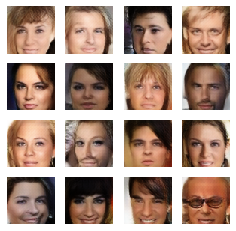

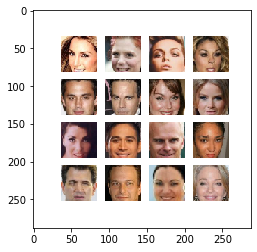

Time for epoch 68 is 211.3756046295166 sec
Gen_loss:  1.24164307 Disc_loss:  1.12100816
Gen_loss:  1.05823576 Disc_loss:  1.04125452
Gen_loss:  1.52102566 Disc_loss:  1.25472498
Gen_loss:  1.18778181 Disc_loss:  1.01731551
Gen_loss:  1.29924774 Disc_loss:  1.24376428
Gen_loss:  1.36147642 Disc_loss:  1.40643859
Gen_loss:  1.07210767 Disc_loss:  1.11094558
Gen_loss:  1.22418487 Disc_loss:  1.10265827
Gen_loss:  1.04543972 Disc_loss:  1.02789354
Gen_loss:  1.0984993 Disc_loss:  1.05537486
Gen_loss:  1.47630119 Disc_loss:  1.06213295
Gen_loss:  1.07849681 Disc_loss:  1.10777938
Gen_loss:  1.14187 Disc_loss:  1.15904391
generate_and_save_images


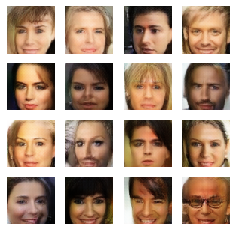

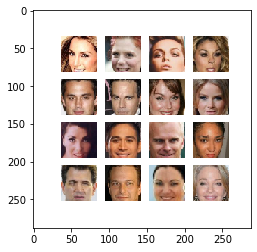

Time for epoch 69 is 212.67502665519714 sec
Gen_loss:  1.38010442 Disc_loss:  0.970627785
Gen_loss:  1.21331906 Disc_loss:  1.01081812
Gen_loss:  1.11161363 Disc_loss:  1.12469602
Gen_loss:  1.40352798 Disc_loss:  1.10403013
Gen_loss:  1.3197403 Disc_loss:  1.20781195
Gen_loss:  1.18089426 Disc_loss:  1.10913312
Gen_loss:  1.18975902 Disc_loss:  1.1446259
Gen_loss:  1.41716611 Disc_loss:  1.11564243
Gen_loss:  1.25528765 Disc_loss:  1.04824066
Gen_loss:  1.54521608 Disc_loss:  1.20941186
Gen_loss:  1.09490216 Disc_loss:  1.15492892
Gen_loss:  1.17331851 Disc_loss:  1.10137272
Gen_loss:  1.27190065 Disc_loss:  1.16199219
Gen_loss:  1.34743392 Disc_loss:  1.13373673
generate_and_save_images


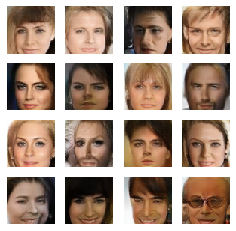

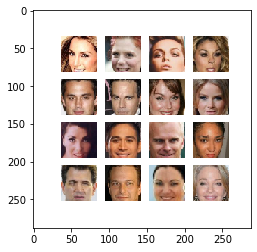

Time for epoch 70 is 211.27802395820618 sec
Gen_loss:  1.25465465 Disc_loss:  1.2667532
Gen_loss:  1.21580756 Disc_loss:  1.16086686
Gen_loss:  0.930673659 Disc_loss:  1.13808608
Gen_loss:  1.37358987 Disc_loss:  1.12404776
Gen_loss:  1.11633 Disc_loss:  0.923728228
Gen_loss:  1.48512113 Disc_loss:  1.02558815
Gen_loss:  1.65048456 Disc_loss:  1.07786679
Gen_loss:  1.21137142 Disc_loss:  1.17374432
Gen_loss:  1.18038619 Disc_loss:  1.12603009
Gen_loss:  1.23629427 Disc_loss:  1.08660102
Gen_loss:  1.40834475 Disc_loss:  1.21869445
Gen_loss:  1.34949684 Disc_loss:  1.03560424
Gen_loss:  1.24826717 Disc_loss:  1.0433774
Gen_loss:  1.62024164 Disc_loss:  1.17837036
generate_and_save_images


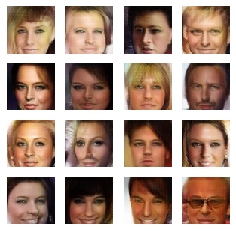

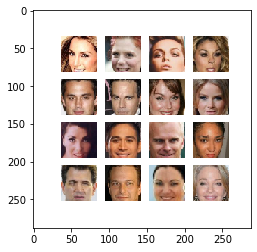

Time for epoch 71 is 210.81431221961975 sec
Gen_loss:  1.32046926 Disc_loss:  1.14713573
Gen_loss:  2.00869417 Disc_loss:  1.64409864
Gen_loss:  1.61833012 Disc_loss:  1.15725887
Gen_loss:  1.20400131 Disc_loss:  1.11531711
Gen_loss:  1.21671665 Disc_loss:  1.05069649
Gen_loss:  1.21649075 Disc_loss:  1.08530378
Gen_loss:  1.32976377 Disc_loss:  1.16923606
Gen_loss:  1.11385643 Disc_loss:  1.07317924
Gen_loss:  1.19084442 Disc_loss:  1.17739105
Gen_loss:  1.0903548 Disc_loss:  1.05180907
Gen_loss:  1.4609741 Disc_loss:  1.29042828
Gen_loss:  1.26560163 Disc_loss:  1.10657549
Gen_loss:  1.14128041 Disc_loss:  1.05767655
Gen_loss:  1.23098564 Disc_loss:  1.0632596
generate_and_save_images


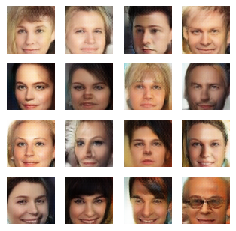

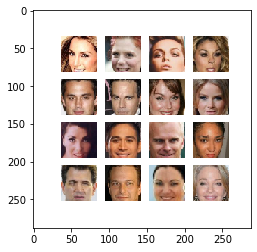

Time for epoch 72 is 211.9976282119751 sec
Gen_loss:  1.21044207 Disc_loss:  1.04294324
Gen_loss:  1.27585924 Disc_loss:  1.17818809
Gen_loss:  1.1739943 Disc_loss:  1.02337
Gen_loss:  1.18405211 Disc_loss:  1.14900959
Gen_loss:  1.45201099 Disc_loss:  1.04163158
Gen_loss:  1.14800572 Disc_loss:  1.04481471
Gen_loss:  1.12907183 Disc_loss:  1.2003808
Gen_loss:  1.15044856 Disc_loss:  1.09874785
Gen_loss:  1.44417667 Disc_loss:  1.11151695
Gen_loss:  1.20227754 Disc_loss:  1.02244711
Gen_loss:  1.41319633 Disc_loss:  1.25348091
Gen_loss:  1.29918361 Disc_loss:  1.19784272
Gen_loss:  1.11712718 Disc_loss:  1.06139612
generate_and_save_images


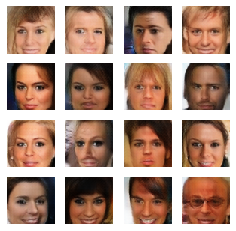

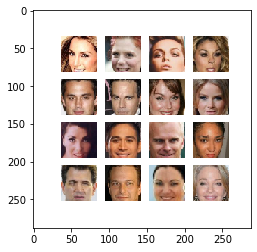

Time for epoch 73 is 211.15649247169495 sec
Gen_loss:  1.07759833 Disc_loss:  1.08895445
Gen_loss:  1.14021659 Disc_loss:  1.20765281
Gen_loss:  1.1095258 Disc_loss:  1.02503026
Gen_loss:  1.28134739 Disc_loss:  1.02066743
Gen_loss:  1.07280469 Disc_loss:  1.03735065
Gen_loss:  1.08862603 Disc_loss:  1.08130229
Gen_loss:  1.2731396 Disc_loss:  1.1297543
Gen_loss:  1.16004205 Disc_loss:  1.08099961
Gen_loss:  1.37261772 Disc_loss:  1.1909126
Gen_loss:  1.09454632 Disc_loss:  1.14247847
Gen_loss:  1.40470886 Disc_loss:  1.12955
Gen_loss:  1.21990538 Disc_loss:  1.08839715
Gen_loss:  1.1780082 Disc_loss:  1.16270244
Gen_loss:  1.36794043 Disc_loss:  1.27223825
generate_and_save_images


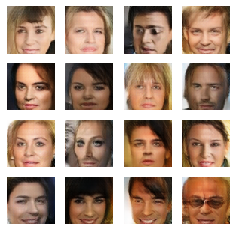

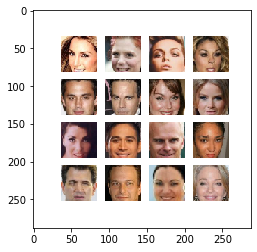

Time for epoch 74 is 211.25222730636597 sec
Gen_loss:  1.33762443 Disc_loss:  1.02317214
Gen_loss:  1.21314299 Disc_loss:  1.1512022
Gen_loss:  1.30372214 Disc_loss:  1.09491539
Gen_loss:  1.30331612 Disc_loss:  1.13721812
Gen_loss:  1.19767666 Disc_loss:  1.21525204
Gen_loss:  1.10304487 Disc_loss:  1.07239223
Gen_loss:  1.50888014 Disc_loss:  1.19345355
Gen_loss:  1.33780074 Disc_loss:  1.21387768
Gen_loss:  1.52719879 Disc_loss:  1.18542969
Gen_loss:  1.27443707 Disc_loss:  1.19169295
Gen_loss:  1.27180862 Disc_loss:  1.06165648
Gen_loss:  1.65382433 Disc_loss:  1.60959017
Gen_loss:  1.19344449 Disc_loss:  1.02900338
Gen_loss:  1.20211065 Disc_loss:  1.03418386
generate_and_save_images


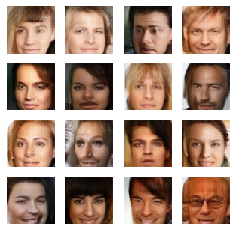

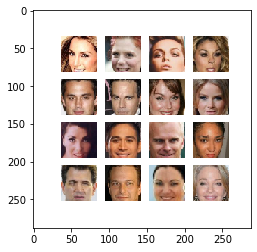

Time for epoch 75 is 211.41872382164001 sec
Gen_loss:  1.3270843 Disc_loss:  1.09497547
Gen_loss:  1.26750362 Disc_loss:  1.21064305
Gen_loss:  1.31983638 Disc_loss:  1.14794767
Gen_loss:  1.18194878 Disc_loss:  1.06955719
Gen_loss:  1.31016302 Disc_loss:  1.07225776
Gen_loss:  1.21034575 Disc_loss:  1.13914132
Gen_loss:  1.72089279 Disc_loss:  1.31300497
Gen_loss:  1.13954604 Disc_loss:  1.06978309
Gen_loss:  1.22014475 Disc_loss:  1.2142247
Gen_loss:  1.23221064 Disc_loss:  1.04598475
Gen_loss:  1.34056425 Disc_loss:  1.11176121
Gen_loss:  1.10298669 Disc_loss:  1.08308172
Gen_loss:  1.20676696 Disc_loss:  1.10789621
Gen_loss:  1.49605632 Disc_loss:  1.09247303
generate_and_save_images


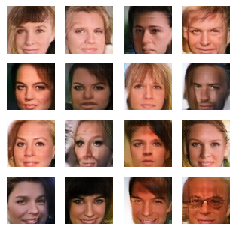

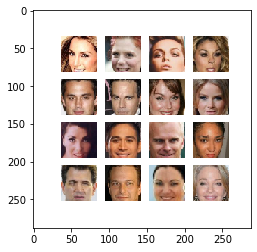

Time for epoch 76 is 211.5991759300232 sec
Gen_loss:  1.16945922 Disc_loss:  1.09313512
Gen_loss:  1.10098791 Disc_loss:  1.0638361
Gen_loss:  1.03559589 Disc_loss:  1.05119622
Gen_loss:  1.27040231 Disc_loss:  1.07452226
Gen_loss:  1.22332954 Disc_loss:  1.08332324
Gen_loss:  1.1125381 Disc_loss:  1.15698993
Gen_loss:  1.43382728 Disc_loss:  1.10329461
Gen_loss:  1.51492238 Disc_loss:  1.01903784
Gen_loss:  1.8117646 Disc_loss:  1.23502612
Gen_loss:  1.5622437 Disc_loss:  1.42301357
Gen_loss:  1.05987465 Disc_loss:  1.12823844
Gen_loss:  1.26435316 Disc_loss:  1.07572436
Gen_loss:  1.12117 Disc_loss:  1.13304281
Gen_loss:  1.10531855 Disc_loss:  1.03871262
generate_and_save_images


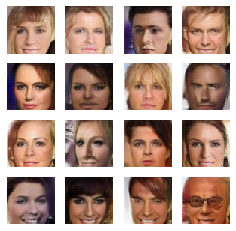

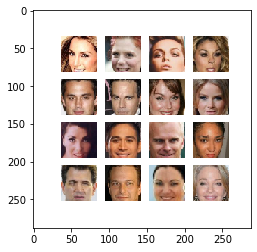

Time for epoch 77 is 211.556298494339 sec
Gen_loss:  1.01424253 Disc_loss:  1.00957739
Gen_loss:  1.17203975 Disc_loss:  1.17133164
Gen_loss:  1.26791191 Disc_loss:  1.00523734
Gen_loss:  1.18844903 Disc_loss:  1.01583743
Gen_loss:  1.1281817 Disc_loss:  1.10304689
Gen_loss:  1.15197814 Disc_loss:  1.00810885
Gen_loss:  1.57196867 Disc_loss:  1.50871992
Gen_loss:  1.24797356 Disc_loss:  1.09388018
Gen_loss:  1.22086632 Disc_loss:  1.1121825
Gen_loss:  0.926228106 Disc_loss:  1.10627484
Gen_loss:  1.43058908 Disc_loss:  1.12820578
Gen_loss:  1.08861256 Disc_loss:  1.13302124
Gen_loss:  1.20883715 Disc_loss:  1.23758554
generate_and_save_images


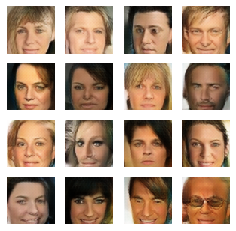

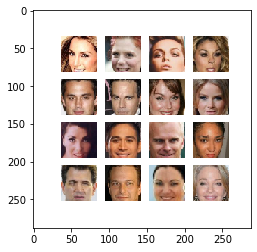

Time for epoch 78 is 211.80402398109436 sec
Gen_loss:  1.2857939 Disc_loss:  1.0464437
Gen_loss:  1.27194405 Disc_loss:  0.997826338
Gen_loss:  1.2258482 Disc_loss:  1.14049911
Gen_loss:  1.31463945 Disc_loss:  1.17338037
Gen_loss:  1.42302322 Disc_loss:  1.23462117
Gen_loss:  1.27752697 Disc_loss:  1.05989456
Gen_loss:  1.38317299 Disc_loss:  0.99643445
Gen_loss:  1.22632408 Disc_loss:  1.18113279
Gen_loss:  1.06279981 Disc_loss:  1.03108907
Gen_loss:  1.40089321 Disc_loss:  1.22955704
Gen_loss:  1.61744416 Disc_loss:  1.14796
Gen_loss:  1.14630103 Disc_loss:  1.0436784
Gen_loss:  1.0998522 Disc_loss:  1.02468193
Gen_loss:  1.35687137 Disc_loss:  0.991137207
generate_and_save_images


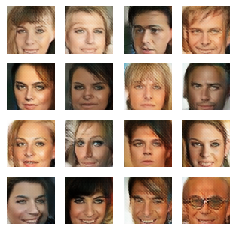

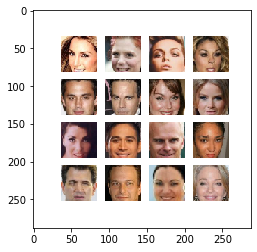

Time for epoch 79 is 211.09922289848328 sec
Gen_loss:  1.46686816 Disc_loss:  1.16774404
Gen_loss:  1.25502849 Disc_loss:  1.18716455
Gen_loss:  1.79283 Disc_loss:  1.31913579
Gen_loss:  1.27840185 Disc_loss:  1.03403711
Gen_loss:  1.4027549 Disc_loss:  1.19249272
Gen_loss:  1.42935228 Disc_loss:  1.15829659
Gen_loss:  1.152794 Disc_loss:  1.17081261
Gen_loss:  1.35831678 Disc_loss:  1.12942433
Gen_loss:  1.37384892 Disc_loss:  1.08271
Gen_loss:  1.06452084 Disc_loss:  1.05675912
Gen_loss:  1.25087845 Disc_loss:  1.05378509
Gen_loss:  1.29188931 Disc_loss:  1.03593659
Gen_loss:  1.41780019 Disc_loss:  1.25568986
Gen_loss:  1.50982189 Disc_loss:  1.33198595
generate_and_save_images


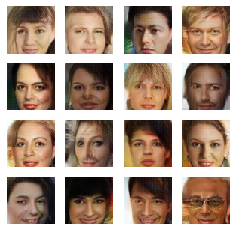

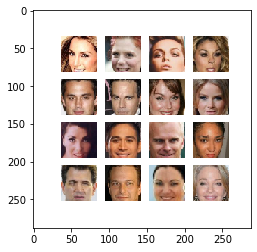

Time for epoch 80 is 211.1412754058838 sec
Gen_loss:  0.966815472 Disc_loss:  1.03781819
Gen_loss:  1.19119191 Disc_loss:  1.14775097
Gen_loss:  1.22092545 Disc_loss:  1.08010912
Gen_loss:  1.07232535 Disc_loss:  1.05358124
Gen_loss:  1.05514669 Disc_loss:  1.01952529
Gen_loss:  1.20993233 Disc_loss:  1.10393369
Gen_loss:  1.18882942 Disc_loss:  1.0442487
Gen_loss:  1.1033349 Disc_loss:  0.930871964
Gen_loss:  1.21410322 Disc_loss:  1.10008883
Gen_loss:  1.07753551 Disc_loss:  1.07288265
Gen_loss:  1.01791787 Disc_loss:  1.22879815
Gen_loss:  1.14191329 Disc_loss:  1.13166189
Gen_loss:  1.25208819 Disc_loss:  1.1522131
Gen_loss:  1.34664083 Disc_loss:  1.36534142
generate_and_save_images


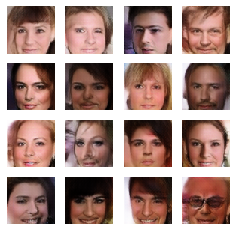

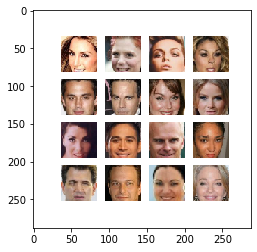

Time for epoch 81 is 210.46272611618042 sec
Gen_loss:  1.19547701 Disc_loss:  1.08549941
Gen_loss:  1.3494978 Disc_loss:  1.11246657
Gen_loss:  1.25716603 Disc_loss:  1.1930244
Gen_loss:  1.13456607 Disc_loss:  1.02381134
Gen_loss:  1.34442878 Disc_loss:  1.03166568
Gen_loss:  1.40619743 Disc_loss:  1.08083904
Gen_loss:  1.23292172 Disc_loss:  1.02867651
Gen_loss:  1.66889417 Disc_loss:  1.21645927
Gen_loss:  1.38408637 Disc_loss:  1.15567374
Gen_loss:  1.62415707 Disc_loss:  1.26739752
Gen_loss:  1.20447767 Disc_loss:  1.01263154
Gen_loss:  1.06393063 Disc_loss:  1.09344316
Gen_loss:  1.16281068 Disc_loss:  0.945859671
generate_and_save_images


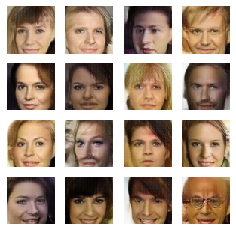

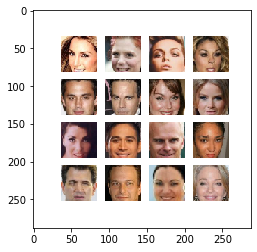

Time for epoch 82 is 211.23507142066956 sec
Gen_loss:  1.24970365 Disc_loss:  0.997902751
Gen_loss:  1.22778094 Disc_loss:  1.1424818
Gen_loss:  1.31033301 Disc_loss:  1.0055629
Gen_loss:  1.45160663 Disc_loss:  1.13214958
Gen_loss:  1.02943981 Disc_loss:  1.10895598
Gen_loss:  1.28816986 Disc_loss:  1.08458352
Gen_loss:  1.4106288 Disc_loss:  1.06472766
Gen_loss:  1.47520041 Disc_loss:  1.31099832
Gen_loss:  1.24764895 Disc_loss:  1.04466534
Gen_loss:  1.23392057 Disc_loss:  1.11081743
Gen_loss:  1.22539377 Disc_loss:  1.12183
Gen_loss:  1.27221632 Disc_loss:  1.25993562
Gen_loss:  1.21051037 Disc_loss:  1.11195266
Gen_loss:  1.31911755 Disc_loss:  1.03990948
generate_and_save_images


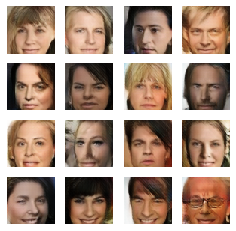

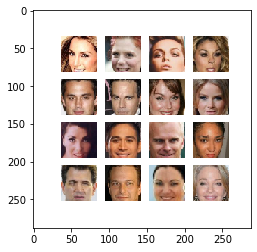

Time for epoch 83 is 210.9735245704651 sec
Gen_loss:  1.28505635 Disc_loss:  1.11488962
Gen_loss:  1.26038277 Disc_loss:  1.13160229
Gen_loss:  1.52054775 Disc_loss:  1.25167632
Gen_loss:  1.16684556 Disc_loss:  1.11665249
Gen_loss:  1.2097553 Disc_loss:  1.03978443
Gen_loss:  1.27089882 Disc_loss:  1.0231514
Gen_loss:  1.45640945 Disc_loss:  1.26764452
Gen_loss:  1.32810569 Disc_loss:  1.05382872
Gen_loss:  1.25100231 Disc_loss:  1.12218142
Gen_loss:  1.45926654 Disc_loss:  1.12802052
Gen_loss:  1.25188541 Disc_loss:  1.10219
Gen_loss:  1.41552186 Disc_loss:  1.18507743
Gen_loss:  1.22226381 Disc_loss:  1.10074162
Gen_loss:  1.23848724 Disc_loss:  1.20634103
generate_and_save_images


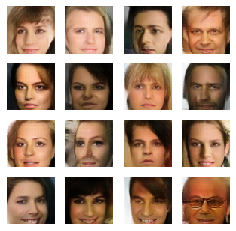

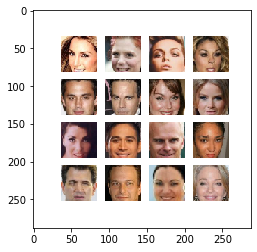

Time for epoch 84 is 211.6769368648529 sec
Gen_loss:  1.60700476 Disc_loss:  1.15885603
Gen_loss:  1.50056243 Disc_loss:  1.02544391
Gen_loss:  1.50772357 Disc_loss:  1.07372022
Gen_loss:  1.18826306 Disc_loss:  1.07811606
Gen_loss:  1.31475616 Disc_loss:  1.00552154
Gen_loss:  1.1174835 Disc_loss:  1.06594276
Gen_loss:  1.04709804 Disc_loss:  1.05477929
Gen_loss:  1.45572317 Disc_loss:  1.09144473
Gen_loss:  0.998818576 Disc_loss:  1.03943896
Gen_loss:  1.2313056 Disc_loss:  1.15561831
Gen_loss:  1.39892173 Disc_loss:  1.21392155
Gen_loss:  1.05030227 Disc_loss:  1.03928721
Gen_loss:  1.23869026 Disc_loss:  1.18981671
Gen_loss:  1.44266677 Disc_loss:  1.34314585
generate_and_save_images


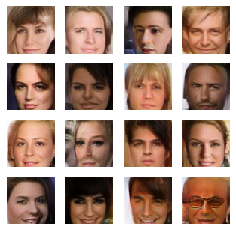

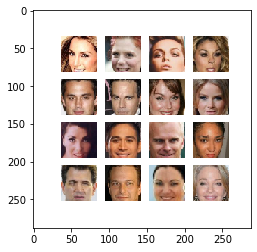

Time for epoch 85 is 210.7070450782776 sec
Gen_loss:  1.10531282 Disc_loss:  1.04233432
Gen_loss:  1.3619082 Disc_loss:  1.10349095
Gen_loss:  1.55912471 Disc_loss:  1.00148904
Gen_loss:  1.16407764 Disc_loss:  0.974719524
Gen_loss:  1.25561452 Disc_loss:  1.01077628
Gen_loss:  1.33852375 Disc_loss:  1.06081176
Gen_loss:  1.14678597 Disc_loss:  1.15629697
Gen_loss:  1.29845202 Disc_loss:  0.998212218
Gen_loss:  1.06947923 Disc_loss:  1.1368407
Gen_loss:  1.1875999 Disc_loss:  1.1073842
Gen_loss:  1.19870949 Disc_loss:  1.11922681
Gen_loss:  1.35406828 Disc_loss:  1.08633435
Gen_loss:  1.16226244 Disc_loss:  1.12306166
Gen_loss:  1.1052773 Disc_loss:  1.17070436
generate_and_save_images


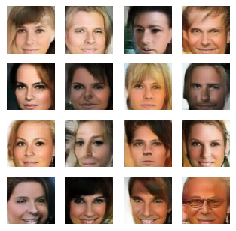

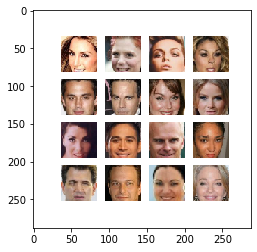

Time for epoch 86 is 210.80763363838196 sec
Gen_loss:  1.15698552 Disc_loss:  1.14230609
Gen_loss:  1.38013637 Disc_loss:  1.18285799
Gen_loss:  1.31179619 Disc_loss:  1.07763338
Gen_loss:  1.36076331 Disc_loss:  1.13848829
Gen_loss:  1.16468716 Disc_loss:  1.20068479
Gen_loss:  1.41497719 Disc_loss:  1.29078722
Gen_loss:  1.0740236 Disc_loss:  1.1703068
Gen_loss:  1.12659359 Disc_loss:  1.1056366
Gen_loss:  1.43575704 Disc_loss:  1.06977177
Gen_loss:  1.99700952 Disc_loss:  1.29879594
Gen_loss:  1.08998811 Disc_loss:  1.18598104
Gen_loss:  1.51669705 Disc_loss:  1.14877987
Gen_loss:  1.46713006 Disc_loss:  1.09629953
generate_and_save_images


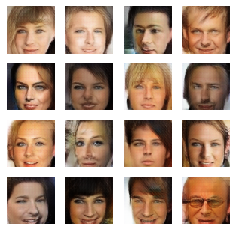

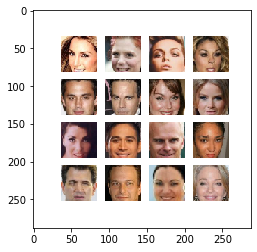

Time for epoch 87 is 210.53624820709229 sec
Gen_loss:  1.5550288 Disc_loss:  1.16788387
Gen_loss:  1.40069854 Disc_loss:  1.02200878
Gen_loss:  1.2209549 Disc_loss:  1.21087217
Gen_loss:  1.08604765 Disc_loss:  1.16488075
Gen_loss:  1.08763707 Disc_loss:  1.04985929
Gen_loss:  1.43277156 Disc_loss:  1.28987622
Gen_loss:  1.1672827 Disc_loss:  1.02057564
Gen_loss:  1.34584618 Disc_loss:  1.12531185
Gen_loss:  1.73552656 Disc_loss:  1.05395103
Gen_loss:  1.08483195 Disc_loss:  1.04696059
Gen_loss:  1.44606507 Disc_loss:  1.10575175
Gen_loss:  1.49524367 Disc_loss:  0.967660785
Gen_loss:  1.50677669 Disc_loss:  1.46353769
Gen_loss:  1.30111337 Disc_loss:  1.196908
generate_and_save_images


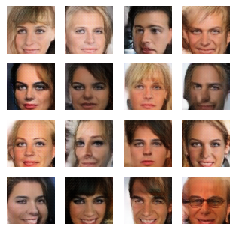

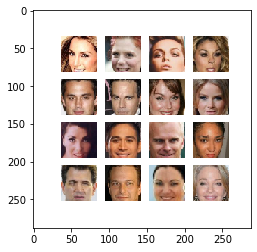

Time for epoch 88 is 211.6434986591339 sec
Gen_loss:  1.14127088 Disc_loss:  0.999078333
Gen_loss:  1.43073332 Disc_loss:  1.10890937
Gen_loss:  1.79976964 Disc_loss:  1.2954334
Gen_loss:  1.1121279 Disc_loss:  1.08060932
Gen_loss:  1.09347105 Disc_loss:  1.128407
Gen_loss:  1.1109972 Disc_loss:  1.02405286
Gen_loss:  1.25906563 Disc_loss:  1.16889894
Gen_loss:  1.32361782 Disc_loss:  1.09570265
Gen_loss:  1.22514975 Disc_loss:  1.13661754
Gen_loss:  1.40668678 Disc_loss:  1.07532454
Gen_loss:  1.23236704 Disc_loss:  1.11170387
Gen_loss:  1.25403929 Disc_loss:  1.02219594
Gen_loss:  1.50278187 Disc_loss:  1.21601
Gen_loss:  1.10647035 Disc_loss:  0.977661967
generate_and_save_images


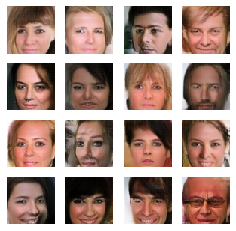

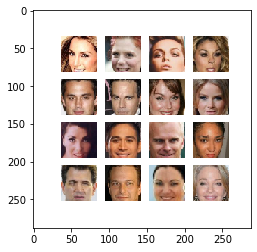

Time for epoch 89 is 210.62189269065857 sec
Gen_loss:  1.11083651 Disc_loss:  1.1152879
Gen_loss:  1.37510955 Disc_loss:  1.20783782
Gen_loss:  1.15453398 Disc_loss:  1.08754468
Gen_loss:  1.63759744 Disc_loss:  1.19847763
Gen_loss:  1.24559128 Disc_loss:  1.04615498
Gen_loss:  1.26678181 Disc_loss:  1.08691955
Gen_loss:  1.26318288 Disc_loss:  1.27484131
Gen_loss:  1.09527946 Disc_loss:  1.12575734
Gen_loss:  1.34347034 Disc_loss:  1.15427148
Gen_loss:  1.36906159 Disc_loss:  1.05826151
Gen_loss:  1.12122881 Disc_loss:  1.00090027
Gen_loss:  1.32222891 Disc_loss:  1.08325362
Gen_loss:  1.23946822 Disc_loss:  1.0819931
Gen_loss:  1.35074413 Disc_loss:  1.21075463
generate_and_save_images


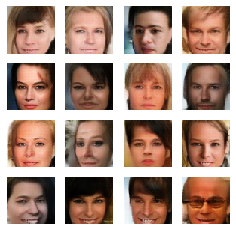

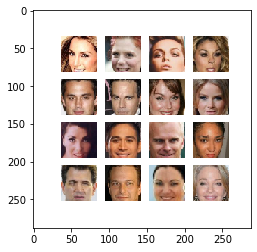

Time for epoch 90 is 211.74864745140076 sec
Gen_loss:  1.42303848 Disc_loss:  1.08464551
Gen_loss:  1.2163111 Disc_loss:  1.13329208
Gen_loss:  1.21664703 Disc_loss:  1.12748408
Gen_loss:  1.33863664 Disc_loss:  1.14956832
Gen_loss:  1.29977691 Disc_loss:  1.0605675
Gen_loss:  1.74555147 Disc_loss:  1.20519269
Gen_loss:  1.45224643 Disc_loss:  1.1555872
Gen_loss:  1.37752664 Disc_loss:  1.04978704
Gen_loss:  1.34868157 Disc_loss:  1.16750598
Gen_loss:  1.08511853 Disc_loss:  1.01486278
Gen_loss:  1.19807661 Disc_loss:  1.09779072
Gen_loss:  1.17382574 Disc_loss:  1.14252305
Gen_loss:  1.4232384 Disc_loss:  1.10025692
generate_and_save_images


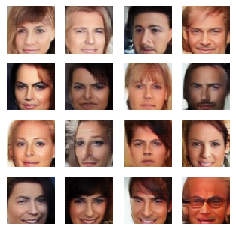

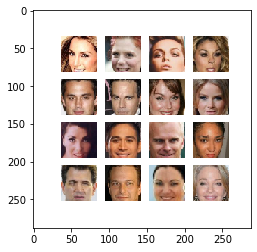

Time for epoch 91 is 211.37856197357178 sec
Gen_loss:  1.26643896 Disc_loss:  0.938156486
Gen_loss:  1.21486676 Disc_loss:  1.15191245
Gen_loss:  1.22229195 Disc_loss:  1.06239939
Gen_loss:  1.17125845 Disc_loss:  1.0277524
Gen_loss:  1.14889169 Disc_loss:  1.11569381
Gen_loss:  1.15961885 Disc_loss:  1.14118648
Gen_loss:  1.2511797 Disc_loss:  1.02511346
Gen_loss:  1.35344446 Disc_loss:  1.14947319
Gen_loss:  1.56177568 Disc_loss:  1.13741672
Gen_loss:  1.18339884 Disc_loss:  1.17213655
Gen_loss:  1.74027956 Disc_loss:  1.03848696
Gen_loss:  1.35378325 Disc_loss:  1.40615439
Gen_loss:  1.53919435 Disc_loss:  1.07507491
Gen_loss:  1.23315072 Disc_loss:  1.14383519
generate_and_save_images


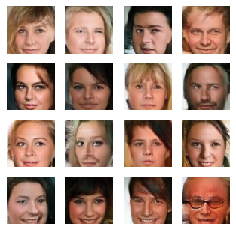

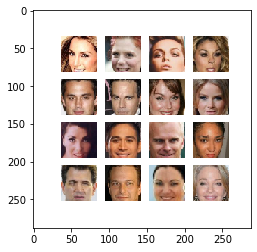

Time for epoch 92 is 210.94109535217285 sec
Gen_loss:  1.09489596 Disc_loss:  1.09287024
Gen_loss:  1.28311062 Disc_loss:  1.10166955
Gen_loss:  1.46670127 Disc_loss:  1.07215846
Gen_loss:  1.07219768 Disc_loss:  1.10760546
Gen_loss:  1.21909571 Disc_loss:  1.18922305
Gen_loss:  1.48753273 Disc_loss:  1.07234514
Gen_loss:  1.59147525 Disc_loss:  1.1684463
Gen_loss:  1.30800581 Disc_loss:  1.08867192
Gen_loss:  1.34530509 Disc_loss:  1.28299093
Gen_loss:  1.15013433 Disc_loss:  1.10601187
Gen_loss:  1.25190461 Disc_loss:  0.972539604
Gen_loss:  1.9625423 Disc_loss:  1.29915309
Gen_loss:  1.21560514 Disc_loss:  0.983825445
Gen_loss:  1.26024616 Disc_loss:  1.03447127
generate_and_save_images


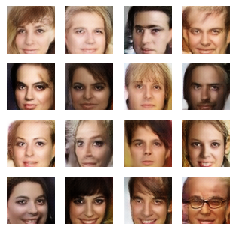

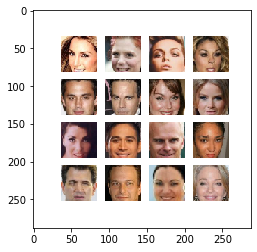

Time for epoch 93 is 210.65311694145203 sec
Gen_loss:  1.58280432 Disc_loss:  1.12376142
Gen_loss:  1.17961562 Disc_loss:  1.01290071
Gen_loss:  1.27513194 Disc_loss:  1.03171098
Gen_loss:  1.28070319 Disc_loss:  1.10501504
Gen_loss:  1.22544217 Disc_loss:  1.27601194
Gen_loss:  1.28106976 Disc_loss:  1.21570897
Gen_loss:  1.41860366 Disc_loss:  1.10079777
Gen_loss:  1.25083089 Disc_loss:  1.20155811
Gen_loss:  1.50010169 Disc_loss:  1.44685757
Gen_loss:  1.4475497 Disc_loss:  1.29286981
Gen_loss:  1.24721587 Disc_loss:  1.17794776
Gen_loss:  1.41946137 Disc_loss:  1.09357691
Gen_loss:  1.07391918 Disc_loss:  1.07446051
Gen_loss:  1.47970462 Disc_loss:  1.16358614
generate_and_save_images


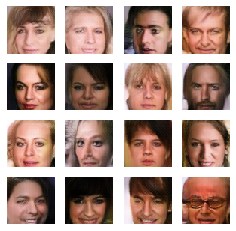

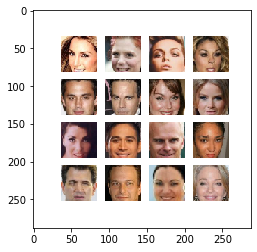

Time for epoch 94 is 211.47694063186646 sec
Gen_loss:  1.21996307 Disc_loss:  0.994288564
Gen_loss:  1.36386359 Disc_loss:  1.00882649
Gen_loss:  1.22661793 Disc_loss:  1.02890575
Gen_loss:  1.07217562 Disc_loss:  1.09301937
Gen_loss:  1.44134724 Disc_loss:  1.1249963
Gen_loss:  1.22887123 Disc_loss:  0.994322658
Gen_loss:  1.22700679 Disc_loss:  1.05902529
Gen_loss:  1.73048985 Disc_loss:  1.26794863
Gen_loss:  1.33950901 Disc_loss:  1.05273938
Gen_loss:  1.53051019 Disc_loss:  1.28410697
Gen_loss:  1.43806326 Disc_loss:  1.1463455
Gen_loss:  1.2137866 Disc_loss:  1.09366214
Gen_loss:  1.20245433 Disc_loss:  1.15339875
Gen_loss:  1.36832774 Disc_loss:  1.0406673
generate_and_save_images


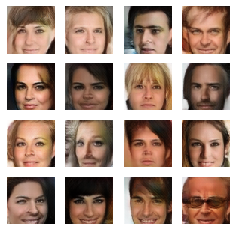

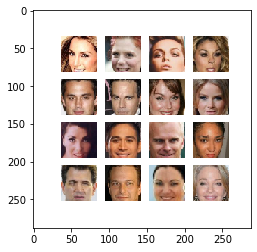

Time for epoch 95 is 211.14568424224854 sec
Gen_loss:  1.10351777 Disc_loss:  1.00082684
Gen_loss:  1.45568609 Disc_loss:  1.34168088
Gen_loss:  1.22025335 Disc_loss:  1.14953327
Gen_loss:  1.21620893 Disc_loss:  1.13294125
Gen_loss:  1.31992102 Disc_loss:  1.04208553
Gen_loss:  1.21606183 Disc_loss:  1.10756803
Gen_loss:  1.30792713 Disc_loss:  0.982457519
Gen_loss:  1.67589223 Disc_loss:  1.24669123
Gen_loss:  1.62746143 Disc_loss:  1.01243615
Gen_loss:  1.32373571 Disc_loss:  1.24592757
Gen_loss:  1.2068851 Disc_loss:  1.23266935
Gen_loss:  1.57316017 Disc_loss:  1.19096613
Gen_loss:  1.18918324 Disc_loss:  1.03370094
generate_and_save_images


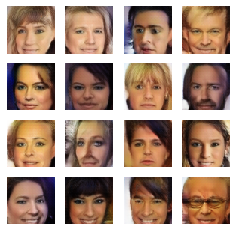

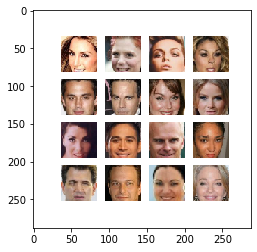

Time for epoch 96 is 211.22901463508606 sec
Gen_loss:  1.44582057 Disc_loss:  1.22473049
Gen_loss:  1.41794479 Disc_loss:  1.18148601
Gen_loss:  1.37436104 Disc_loss:  1.45516276
Gen_loss:  1.19395304 Disc_loss:  1.23596787
Gen_loss:  1.46381509 Disc_loss:  1.19583881
Gen_loss:  1.45470273 Disc_loss:  1.05199301
Gen_loss:  1.19872618 Disc_loss:  1.05908287
Gen_loss:  1.37138581 Disc_loss:  1.16466033
Gen_loss:  1.18942022 Disc_loss:  1.11443019
Gen_loss:  1.28088081 Disc_loss:  1.08829331
Gen_loss:  1.49382055 Disc_loss:  1.04938233
Gen_loss:  1.65908444 Disc_loss:  1.12083364
Gen_loss:  1.1981777 Disc_loss:  1.13687038
Gen_loss:  1.54167104 Disc_loss:  0.995206714
generate_and_save_images


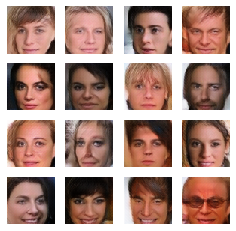

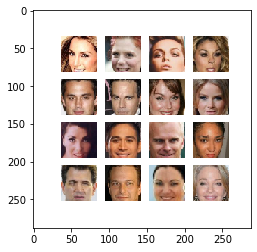

Time for epoch 97 is 211.45441913604736 sec
Gen_loss:  1.10927641 Disc_loss:  1.04896927
Gen_loss:  1.23259342 Disc_loss:  1.22125721
Gen_loss:  1.3110199 Disc_loss:  1.23148894
Gen_loss:  1.41915131 Disc_loss:  1.12313163
Gen_loss:  1.44250929 Disc_loss:  1.36065209
Gen_loss:  1.39696789 Disc_loss:  1.07612538
Gen_loss:  1.13700557 Disc_loss:  1.20864928
Gen_loss:  1.49629819 Disc_loss:  1.15422988
Gen_loss:  1.38911474 Disc_loss:  1.26665759
Gen_loss:  1.28709316 Disc_loss:  0.949005961
Gen_loss:  1.13205218 Disc_loss:  1.16615343
Gen_loss:  1.10336375 Disc_loss:  1.03341258
Gen_loss:  1.36691499 Disc_loss:  1.15567672
Gen_loss:  1.37682414 Disc_loss:  1.1924175
generate_and_save_images


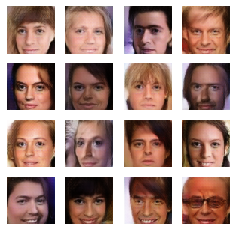

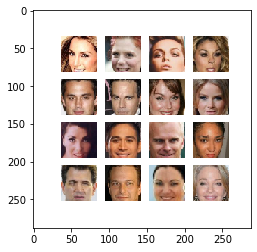

Time for epoch 98 is 210.60840725898743 sec
Gen_loss:  1.96776938 Disc_loss:  1.18298268
Gen_loss:  1.21508694 Disc_loss:  1.17191434
Gen_loss:  0.946564794 Disc_loss:  1.1716156
Gen_loss:  1.16864967 Disc_loss:  1.05118585
Gen_loss:  1.09949696 Disc_loss:  1.10588157
Gen_loss:  1.20210743 Disc_loss:  1.06523454
Gen_loss:  1.20681405 Disc_loss:  1.15630305
Gen_loss:  1.16379273 Disc_loss:  1.05257988
Gen_loss:  1.12469912 Disc_loss:  1.0182364
Gen_loss:  1.70959902 Disc_loss:  1.2274003
Gen_loss:  1.2986517 Disc_loss:  1.25809658
Gen_loss:  1.41460514 Disc_loss:  0.999242961
Gen_loss:  1.3942157 Disc_loss:  1.10181224
Gen_loss:  1.32546926 Disc_loss:  1.06537378
generate_and_save_images


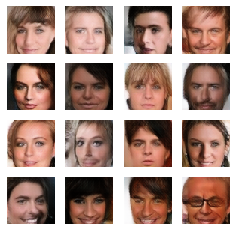

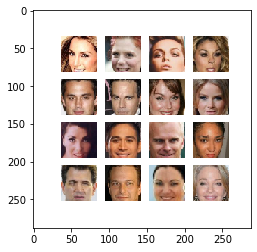

Time for epoch 99 is 211.37296342849731 sec
Gen_loss:  1.50899911 Disc_loss:  1.07207298
Gen_loss:  1.31873226 Disc_loss:  1.07933903
Gen_loss:  1.1817199 Disc_loss:  1.06443679
Gen_loss:  1.26063418 Disc_loss:  1.0749526
Gen_loss:  1.22094858 Disc_loss:  0.939308584
Gen_loss:  1.3055824 Disc_loss:  1.22810471
Gen_loss:  1.3906765 Disc_loss:  1.24510944
Gen_loss:  1.41443682 Disc_loss:  1.41043556
Gen_loss:  1.45996356 Disc_loss:  1.25018573
Gen_loss:  1.28233671 Disc_loss:  1.06215644
Gen_loss:  1.36604917 Disc_loss:  1.22600675
Gen_loss:  1.18438101 Disc_loss:  1.01873243
Gen_loss:  1.48881781 Disc_loss:  0.982394755
Gen_loss:  1.25994587 Disc_loss:  1.11194539
generate_and_save_images


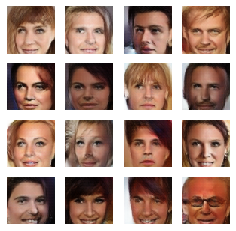

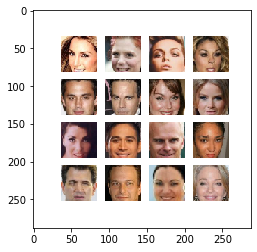

Time for epoch 100 is 212.1192262172699 sec
Gen_loss:  1.65206718 Disc_loss:  1.28714502
Gen_loss:  1.07151818 Disc_loss:  1.07377172
Gen_loss:  1.48972034 Disc_loss:  1.11063039
Gen_loss:  1.22243023 Disc_loss:  1.00778043
Gen_loss:  1.40256608 Disc_loss:  1.13122177
Gen_loss:  1.17665517 Disc_loss:  1.09730494
Gen_loss:  0.941589594 Disc_loss:  1.15325868
Gen_loss:  1.39079142 Disc_loss:  1.02522051
Gen_loss:  1.35258365 Disc_loss:  1.13978171
Gen_loss:  1.46216655 Disc_loss:  0.950871646
Gen_loss:  1.49212253 Disc_loss:  1.43597317
Gen_loss:  1.69449067 Disc_loss:  1.13784647
Gen_loss:  1.35401297 Disc_loss:  1.08666599
generate_and_save_images


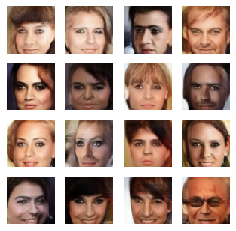

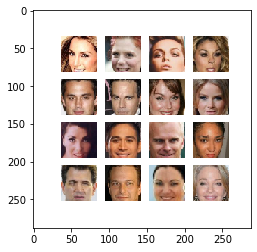

Time for epoch 101 is 211.7125518321991 sec
Gen_loss:  1.12394238 Disc_loss:  1.06563127
Gen_loss:  1.21801853 Disc_loss:  1.12626207
Gen_loss:  1.9927659 Disc_loss:  1.1807152
Gen_loss:  1.28265715 Disc_loss:  1.15736163
Gen_loss:  1.84231317 Disc_loss:  1.40031898
Gen_loss:  1.03556705 Disc_loss:  1.079759
Gen_loss:  1.08066618 Disc_loss:  1.15258789
Gen_loss:  1.36210299 Disc_loss:  1.13496935
Gen_loss:  1.35714829 Disc_loss:  1.25471556
Gen_loss:  1.02184618 Disc_loss:  1.07242703
Gen_loss:  1.37315953 Disc_loss:  1.17666018
Gen_loss:  1.26440287 Disc_loss:  1.05236626
Gen_loss:  1.21988273 Disc_loss:  1.07745719
Gen_loss:  1.15659904 Disc_loss:  0.979475915
generate_and_save_images


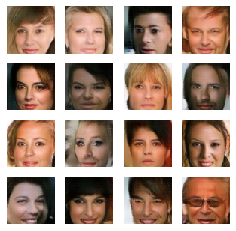

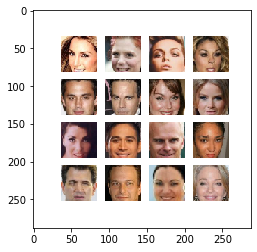

Time for epoch 102 is 212.04819512367249 sec
Gen_loss:  1.39185917 Disc_loss:  1.18352842
Gen_loss:  1.3959018 Disc_loss:  1.02885973
Gen_loss:  1.40231168 Disc_loss:  1.00643587
Gen_loss:  1.29822993 Disc_loss:  1.06195688
Gen_loss:  1.16388166 Disc_loss:  1.10145295
Gen_loss:  1.4375515 Disc_loss:  1.02949345
Gen_loss:  1.25328422 Disc_loss:  1.09671378
Gen_loss:  1.16400421 Disc_loss:  1.0115186
Gen_loss:  1.12348545 Disc_loss:  1.08262432
Gen_loss:  1.19233561 Disc_loss:  1.04301965
Gen_loss:  1.40858626 Disc_loss:  1.0313
Gen_loss:  1.24161 Disc_loss:  1.16700304
Gen_loss:  1.2155937 Disc_loss:  1.01716805
Gen_loss:  1.39114904 Disc_loss:  1.01224983
generate_and_save_images


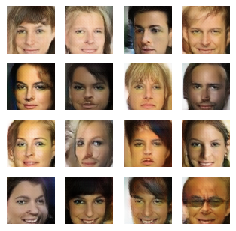

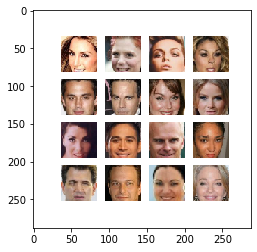

Time for epoch 103 is 211.49136400222778 sec
Gen_loss:  1.2583226 Disc_loss:  0.997788787
Gen_loss:  1.20668244 Disc_loss:  0.977649868
Gen_loss:  1.1846565 Disc_loss:  0.987174034
Gen_loss:  1.53235614 Disc_loss:  1.1424768
Gen_loss:  1.30980551 Disc_loss:  1.14880443
Gen_loss:  1.50914872 Disc_loss:  1.18599546
Gen_loss:  1.30238128 Disc_loss:  1.01913011
Gen_loss:  1.28195667 Disc_loss:  1.10475421
Gen_loss:  1.49031699 Disc_loss:  1.36205101
Gen_loss:  1.36438107 Disc_loss:  1.20214
Gen_loss:  1.10853255 Disc_loss:  1.01905298
Gen_loss:  1.41300285 Disc_loss:  1.23012877
Gen_loss:  1.6296097 Disc_loss:  1.31178737
Gen_loss:  1.25602055 Disc_loss:  1.04178715
generate_and_save_images


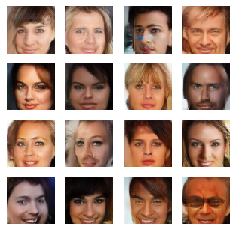

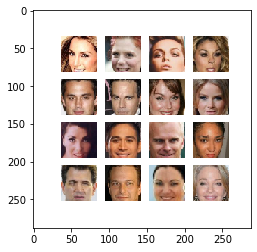

Time for epoch 104 is 211.04614233970642 sec
Gen_loss:  1.1176157 Disc_loss:  1.0113039
Gen_loss:  1.28537226 Disc_loss:  0.997662067
Gen_loss:  1.35586333 Disc_loss:  1.1200732
Gen_loss:  1.09042335 Disc_loss:  1.11496353
Gen_loss:  1.47517133 Disc_loss:  1.08951151
Gen_loss:  1.35059869 Disc_loss:  1.16697955
Gen_loss:  1.32439768 Disc_loss:  1.20121908
Gen_loss:  1.5297823 Disc_loss:  1.39210284
Gen_loss:  1.46174359 Disc_loss:  1.05588675
Gen_loss:  1.34998918 Disc_loss:  1.08991551
Gen_loss:  1.3920089 Disc_loss:  1.19549322
Gen_loss:  1.04478216 Disc_loss:  1.05003583
Gen_loss:  1.43526697 Disc_loss:  1.04747403
generate_and_save_images


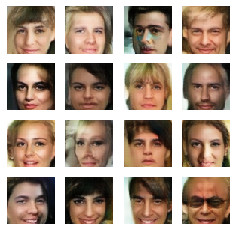

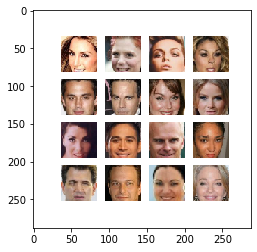

Time for epoch 105 is 211.1374855041504 sec
Gen_loss:  1.30421627 Disc_loss:  1.05249691
Gen_loss:  1.17981911 Disc_loss:  1.17249632
Gen_loss:  1.08644056 Disc_loss:  1.11466491
Gen_loss:  1.12503922 Disc_loss:  1.09052753
Gen_loss:  1.33363366 Disc_loss:  1.1153841
Gen_loss:  1.12955761 Disc_loss:  1.22172785
Gen_loss:  1.16587782 Disc_loss:  1.00235403
Gen_loss:  1.28158796 Disc_loss:  1.02904522
Gen_loss:  1.38536918 Disc_loss:  1.1203444
Gen_loss:  1.21814609 Disc_loss:  1.08041775
Gen_loss:  1.53540993 Disc_loss:  1.08737373
Gen_loss:  1.5323081 Disc_loss:  0.998250306
Gen_loss:  1.22303128 Disc_loss:  1.23255491
Gen_loss:  1.49223435 Disc_loss:  1.14563155
generate_and_save_images


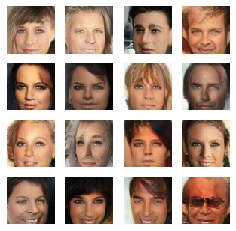

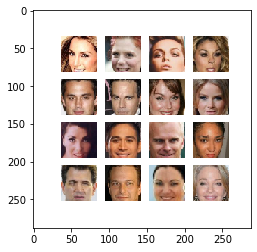

Time for epoch 106 is 211.77598309516907 sec
Gen_loss:  1.37147784 Disc_loss:  1.12160277
Gen_loss:  1.7961787 Disc_loss:  1.13328695
Gen_loss:  1.10536551 Disc_loss:  1.18955183
Gen_loss:  1.47931314 Disc_loss:  1.02656233
Gen_loss:  1.2725116 Disc_loss:  0.983595967
Gen_loss:  1.32713318 Disc_loss:  1.18742526
Gen_loss:  1.31167257 Disc_loss:  1.12177634
Gen_loss:  1.24031985 Disc_loss:  1.18248689
Gen_loss:  1.18531871 Disc_loss:  1.1036427
Gen_loss:  1.29380596 Disc_loss:  0.949517787
Gen_loss:  1.07202041 Disc_loss:  1.04253554
Gen_loss:  1.56566274 Disc_loss:  1.14294159
Gen_loss:  1.41250396 Disc_loss:  1.09951043
Gen_loss:  1.25261855 Disc_loss:  1.14842045
generate_and_save_images


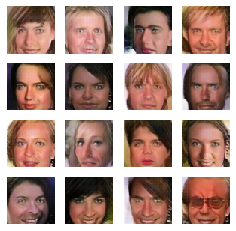

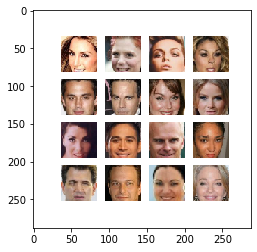

Time for epoch 107 is 211.7672200202942 sec
Gen_loss:  1.32946754 Disc_loss:  1.42699862
Gen_loss:  1.27956343 Disc_loss:  1.12514389
Gen_loss:  1.29496312 Disc_loss:  0.921053171
Gen_loss:  1.33134341 Disc_loss:  1.02236104
Gen_loss:  1.17944407 Disc_loss:  0.980203271
Gen_loss:  1.22616756 Disc_loss:  1.05416954
Gen_loss:  1.18891215 Disc_loss:  0.936120927
Gen_loss:  1.5131166 Disc_loss:  1.25425363
Gen_loss:  1.65781033 Disc_loss:  1.01574421
Gen_loss:  1.61728084 Disc_loss:  1.21341515
Gen_loss:  1.07198548 Disc_loss:  1.0951426
Gen_loss:  1.2832346 Disc_loss:  0.967104793
Gen_loss:  1.59356213 Disc_loss:  1.05365086
Gen_loss:  1.57561851 Disc_loss:  1.33946145
generate_and_save_images


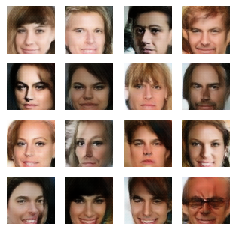

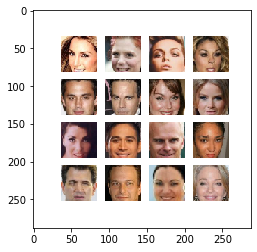

Time for epoch 108 is 210.69623804092407 sec
Gen_loss:  1.14077377 Disc_loss:  1.20418787
Gen_loss:  1.04931951 Disc_loss:  1.04805875
Gen_loss:  1.5810672 Disc_loss:  1.11234975
Gen_loss:  1.15653205 Disc_loss:  1.13924503
Gen_loss:  1.24422014 Disc_loss:  1.04524434
Gen_loss:  1.43195331 Disc_loss:  1.06999
Gen_loss:  1.58391273 Disc_loss:  1.32350743
Gen_loss:  1.51244521 Disc_loss:  1.13889062
Gen_loss:  1.4019109 Disc_loss:  1.15209079
Gen_loss:  1.14415717 Disc_loss:  1.0444895
Gen_loss:  1.48894787 Disc_loss:  1.12997317
Gen_loss:  1.07096946 Disc_loss:  1.12188959
Gen_loss:  1.08648646 Disc_loss:  1.13677692
Gen_loss:  1.34356546 Disc_loss:  1.15853155
generate_and_save_images


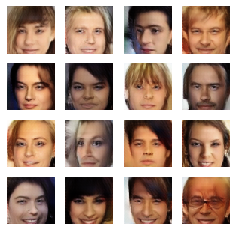

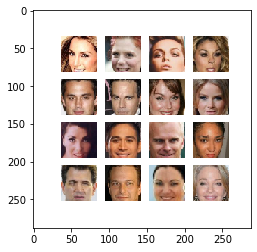

Time for epoch 109 is 211.4917049407959 sec
Gen_loss:  1.06465197 Disc_loss:  1.07501078
Gen_loss:  1.09058607 Disc_loss:  1.02891922
Gen_loss:  1.85658443 Disc_loss:  1.03758526
Gen_loss:  1.49117756 Disc_loss:  1.22494292
Gen_loss:  1.08877039 Disc_loss:  1.06631315
Gen_loss:  1.4149096 Disc_loss:  0.970037699
Gen_loss:  1.53104806 Disc_loss:  1.06960046
Gen_loss:  1.30806661 Disc_loss:  1.1550653
Gen_loss:  1.56517 Disc_loss:  1.11465573
Gen_loss:  1.32658637 Disc_loss:  1.1959461
Gen_loss:  1.23257065 Disc_loss:  1.13747144
Gen_loss:  1.25810766 Disc_loss:  1.0064199
Gen_loss:  1.3609221 Disc_loss:  0.960040927
generate_and_save_images


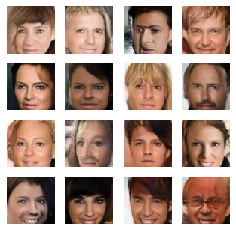

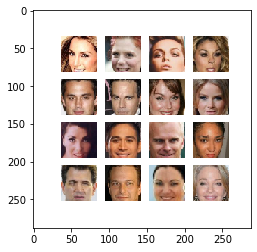

Time for epoch 110 is 211.3905532360077 sec
Gen_loss:  1.19205415 Disc_loss:  1.03742051
Gen_loss:  1.61601686 Disc_loss:  1.1092838
Gen_loss:  1.16989255 Disc_loss:  0.977852464
Gen_loss:  1.35559595 Disc_loss:  1.23213184
Gen_loss:  1.20762706 Disc_loss:  1.11062074
Gen_loss:  1.31018007 Disc_loss:  1.02430713
Gen_loss:  1.2256465 Disc_loss:  1.12313151
Gen_loss:  1.46437621 Disc_loss:  1.01704216
Gen_loss:  1.17112744 Disc_loss:  1.11611271
Gen_loss:  1.55210662 Disc_loss:  1.4926281
Gen_loss:  1.35082746 Disc_loss:  1.13834286
Gen_loss:  1.11236119 Disc_loss:  1.10079336
Gen_loss:  1.48289776 Disc_loss:  0.980580688
Gen_loss:  1.62263143 Disc_loss:  1.23350394
generate_and_save_images


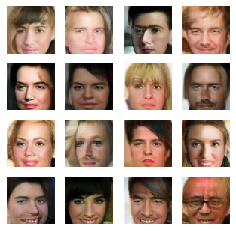

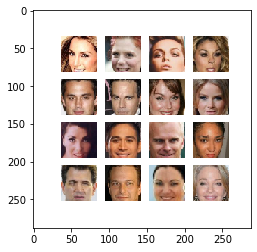

Time for epoch 111 is 211.1412844657898 sec
Gen_loss:  1.38825262 Disc_loss:  1.19691682
Gen_loss:  1.34898961 Disc_loss:  1.04013765
Gen_loss:  1.14512479 Disc_loss:  1.10727823
Gen_loss:  1.84631109 Disc_loss:  1.76447093
Gen_loss:  1.35618424 Disc_loss:  1.04693699
Gen_loss:  1.24031854 Disc_loss:  1.07330108
Gen_loss:  1.17575705 Disc_loss:  1.1697787
Gen_loss:  1.21867359 Disc_loss:  1.17876959
Gen_loss:  1.17507219 Disc_loss:  1.08202589
Gen_loss:  1.15704596 Disc_loss:  1.02080142
Gen_loss:  1.63328 Disc_loss:  1.29486871
Gen_loss:  1.49288285 Disc_loss:  1.12853599
Gen_loss:  1.20089245 Disc_loss:  1.01248503
Gen_loss:  1.20731759 Disc_loss:  1.12721586
generate_and_save_images


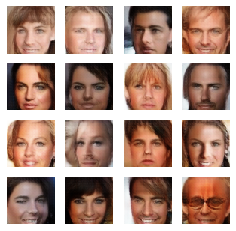

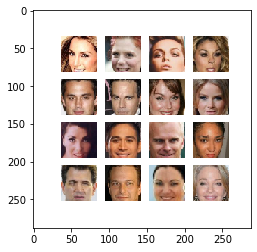

Time for epoch 112 is 211.3186478614807 sec
Gen_loss:  1.15942645 Disc_loss:  1.04896069
Gen_loss:  1.62479556 Disc_loss:  1.03812921
Gen_loss:  1.23325181 Disc_loss:  1.19789362
Gen_loss:  1.30554581 Disc_loss:  1.1038506
Gen_loss:  1.08546019 Disc_loss:  1.08008671
Gen_loss:  1.26654768 Disc_loss:  0.952902138
Gen_loss:  1.31379867 Disc_loss:  1.11520183
Gen_loss:  1.15902245 Disc_loss:  0.976537943
Gen_loss:  1.38931489 Disc_loss:  1.07499766
Gen_loss:  1.17873597 Disc_loss:  1.04010642
Gen_loss:  1.24442744 Disc_loss:  1.11675549
Gen_loss:  1.66357958 Disc_loss:  1.19382429
Gen_loss:  1.82012939 Disc_loss:  1.41136301
Gen_loss:  1.18860483 Disc_loss:  1.09745717
generate_and_save_images


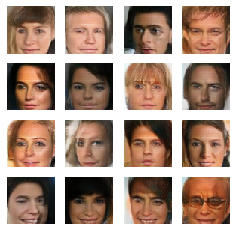

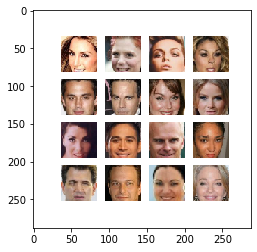

Time for epoch 113 is 211.06723833084106 sec
Gen_loss:  1.22369301 Disc_loss:  1.09719217
Gen_loss:  1.50452769 Disc_loss:  1.08705437
Gen_loss:  1.50121748 Disc_loss:  1.22746313
Gen_loss:  1.48609746 Disc_loss:  1.23016512
Gen_loss:  1.1904453 Disc_loss:  1.0049535
Gen_loss:  1.17005491 Disc_loss:  1.02887547
Gen_loss:  1.31882679 Disc_loss:  1.13354599
Gen_loss:  1.17285013 Disc_loss:  1.06988108
Gen_loss:  1.34667742 Disc_loss:  1.18919563
Gen_loss:  1.26370227 Disc_loss:  1.26573443
Gen_loss:  1.30236888 Disc_loss:  1.10898852
Gen_loss:  1.18547332 Disc_loss:  1.16979694
Gen_loss:  1.23953164 Disc_loss:  1.18885767
generate_and_save_images


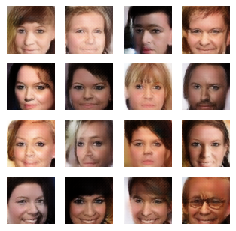

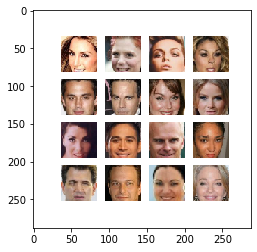

Time for epoch 114 is 211.1383774280548 sec
Gen_loss:  1.29849732 Disc_loss:  1.29997087
Gen_loss:  1.32358527 Disc_loss:  1.02899885
Gen_loss:  1.27157843 Disc_loss:  1.15243697
Gen_loss:  1.62928963 Disc_loss:  1.3855629
Gen_loss:  1.49635196 Disc_loss:  1.00496
Gen_loss:  1.23235106 Disc_loss:  1.14577663
Gen_loss:  1.2803123 Disc_loss:  1.1626544
Gen_loss:  1.36047983 Disc_loss:  1.24062347
Gen_loss:  1.38175786 Disc_loss:  1.10126626
Gen_loss:  1.29661369 Disc_loss:  1.19430923
Gen_loss:  1.41175449 Disc_loss:  1.13670301
Gen_loss:  1.3375634 Disc_loss:  1.12895179
Gen_loss:  1.28937709 Disc_loss:  1.06823337
Gen_loss:  1.15564656 Disc_loss:  0.868778944
generate_and_save_images


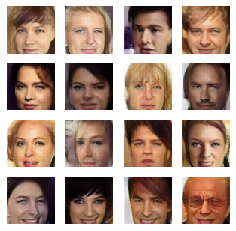

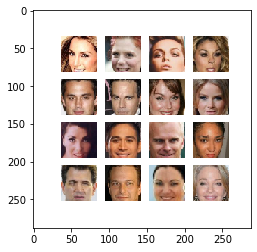

Time for epoch 115 is 211.9549949169159 sec
Gen_loss:  1.14152455 Disc_loss:  1.10267508
Gen_loss:  1.33093369 Disc_loss:  0.997251332
Gen_loss:  1.85832393 Disc_loss:  1.37495887
Gen_loss:  1.57796884 Disc_loss:  1.11107707
Gen_loss:  1.35033941 Disc_loss:  1.10424578
Gen_loss:  1.45724225 Disc_loss:  1.25542986
Gen_loss:  1.53656387 Disc_loss:  1.20723414
Gen_loss:  1.42463183 Disc_loss:  0.958996296
Gen_loss:  1.27783966 Disc_loss:  0.97962
Gen_loss:  1.25875604 Disc_loss:  1.09162188
Gen_loss:  1.22797799 Disc_loss:  1.04600191
Gen_loss:  1.28702688 Disc_loss:  1.05484629
Gen_loss:  1.32495081 Disc_loss:  1.05796933
Gen_loss:  1.20589578 Disc_loss:  1.08816528
generate_and_save_images


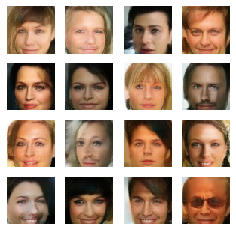

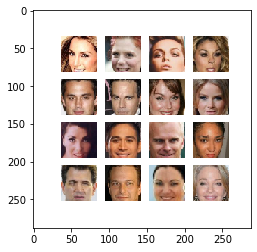

Time for epoch 116 is 211.23278141021729 sec
Gen_loss:  1.14925945 Disc_loss:  0.915318668
Gen_loss:  1.15586483 Disc_loss:  1.07475841
Gen_loss:  1.2456677 Disc_loss:  1.08920991
Gen_loss:  1.33066058 Disc_loss:  0.96289289
Gen_loss:  1.21669555 Disc_loss:  1.21275687
Gen_loss:  1.3704915 Disc_loss:  1.16039336
Gen_loss:  1.65323532 Disc_loss:  1.08130491
Gen_loss:  1.36035252 Disc_loss:  1.12596154
Gen_loss:  1.4497664 Disc_loss:  1.04092085
Gen_loss:  1.37501979 Disc_loss:  1.05009007
Gen_loss:  1.3756125 Disc_loss:  1.10781455
Gen_loss:  1.45302749 Disc_loss:  1.32709575
Gen_loss:  1.23018944 Disc_loss:  1.16611457
Gen_loss:  1.94465983 Disc_loss:  1.42053926
generate_and_save_images


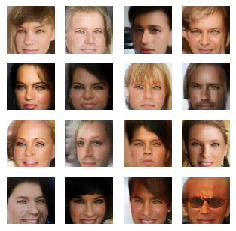

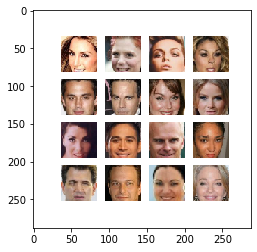

Time for epoch 117 is 211.3118965625763 sec
Gen_loss:  1.12369919 Disc_loss:  1.02339888
Gen_loss:  1.35160124 Disc_loss:  1.03323078
Gen_loss:  1.31408978 Disc_loss:  1.2234745
Gen_loss:  1.32266855 Disc_loss:  1.1644187
Gen_loss:  1.11739099 Disc_loss:  1.10792255
Gen_loss:  1.14674902 Disc_loss:  1.09114075
Gen_loss:  1.27031851 Disc_loss:  1.12501216
Gen_loss:  1.09537041 Disc_loss:  1.10941303
Gen_loss:  1.31657267 Disc_loss:  1.11547804
Gen_loss:  1.17060244 Disc_loss:  1.14955747
Gen_loss:  1.46634793 Disc_loss:  1.02326298
Gen_loss:  1.35867655 Disc_loss:  1.17091334
Gen_loss:  1.64247823 Disc_loss:  1.4410001
Gen_loss:  1.0943433 Disc_loss:  1.00806201
generate_and_save_images


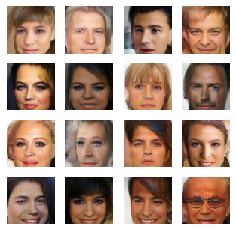

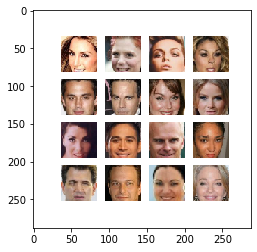

Time for epoch 118 is 211.29663825035095 sec
Gen_loss:  1.2495147 Disc_loss:  1.10875416
Gen_loss:  1.34509873 Disc_loss:  1.10983419
Gen_loss:  1.35323703 Disc_loss:  1.37182009
Gen_loss:  1.15245914 Disc_loss:  1.10412824
Gen_loss:  1.34750903 Disc_loss:  1.17116523
Gen_loss:  1.3412962 Disc_loss:  1.04212403
Gen_loss:  1.17247808 Disc_loss:  1.20673442
Gen_loss:  1.15158832 Disc_loss:  1.10251141
Gen_loss:  1.39144468 Disc_loss:  1.01979256
Gen_loss:  1.23789787 Disc_loss:  1.11819839
Gen_loss:  1.35812426 Disc_loss:  1.00134647
Gen_loss:  1.27312469 Disc_loss:  1.19247496
Gen_loss:  1.31963336 Disc_loss:  1.21008372
generate_and_save_images


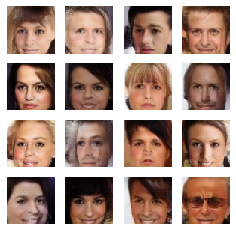

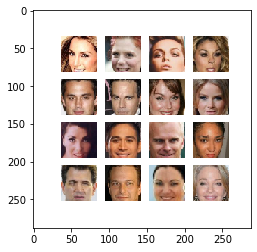

Time for epoch 119 is 210.95633959770203 sec
Gen_loss:  1.44572163 Disc_loss:  1.23987675
Gen_loss:  1.04183054 Disc_loss:  1.21295881
Gen_loss:  1.17782485 Disc_loss:  1.07657909
Gen_loss:  1.34619761 Disc_loss:  1.15801954
Gen_loss:  1.621261 Disc_loss:  0.971329212
Gen_loss:  1.50639987 Disc_loss:  1.25177884
Gen_loss:  1.40304744 Disc_loss:  0.986198068
Gen_loss:  1.29289556 Disc_loss:  1.21426594
Gen_loss:  1.36487138 Disc_loss:  1.22961354
Gen_loss:  1.23048329 Disc_loss:  1.0495379
Gen_loss:  1.43015909 Disc_loss:  1.08851421
Gen_loss:  0.870882034 Disc_loss:  1.17146814
Gen_loss:  1.09922183 Disc_loss:  1.13882363
Gen_loss:  1.19969916 Disc_loss:  1.11290884
generate_and_save_images


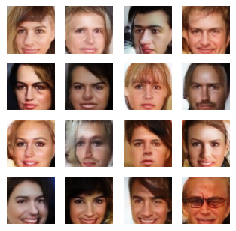

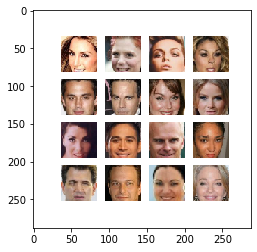

Time for epoch 120 is 212.19682788848877 sec
Gen_loss:  1.19443822 Disc_loss:  1.07205987
Gen_loss:  1.54290295 Disc_loss:  1.26391268
Gen_loss:  1.38234723 Disc_loss:  1.18988252
Gen_loss:  1.77059126 Disc_loss:  1.53760278
Gen_loss:  1.32307518 Disc_loss:  1.11799335
Gen_loss:  1.10921109 Disc_loss:  1.11407542
Gen_loss:  1.29259825 Disc_loss:  1.22913229
Gen_loss:  1.17154145 Disc_loss:  1.06878698
Gen_loss:  1.15368247 Disc_loss:  1.17454731
Gen_loss:  1.17675734 Disc_loss:  1.06758189
Gen_loss:  1.21283841 Disc_loss:  0.948610842
Gen_loss:  1.42335618 Disc_loss:  1.1877141
Gen_loss:  1.211761 Disc_loss:  1.1385994
Gen_loss:  1.61384034 Disc_loss:  1.13402927
generate_and_save_images


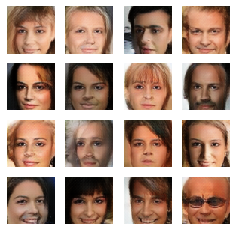

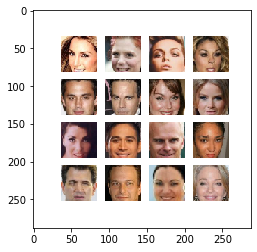

Time for epoch 121 is 210.99239826202393 sec
Gen_loss:  1.60779679 Disc_loss:  0.985078514
Gen_loss:  1.22797656 Disc_loss:  1.00782812
Gen_loss:  1.24980605 Disc_loss:  0.976563811
Gen_loss:  1.462538 Disc_loss:  1.09353387
Gen_loss:  1.15497208 Disc_loss:  1.01029778
Gen_loss:  1.1405344 Disc_loss:  1.04500532
Gen_loss:  1.13004553 Disc_loss:  1.12547779
Gen_loss:  1.25640023 Disc_loss:  1.19007397
Gen_loss:  1.12829816 Disc_loss:  1.19172
Gen_loss:  1.54724216 Disc_loss:  1.50555277
Gen_loss:  1.25906658 Disc_loss:  1.00273
Gen_loss:  1.57550728 Disc_loss:  1.07884073
Gen_loss:  1.57642317 Disc_loss:  1.43481195
Gen_loss:  1.34818971 Disc_loss:  1.30358911
generate_and_save_images


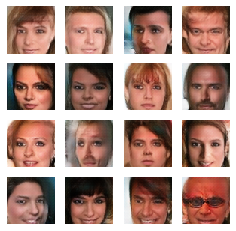

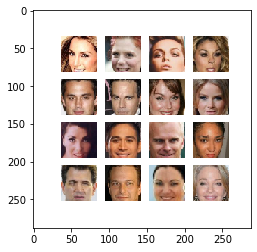

Time for epoch 122 is 211.1162405014038 sec
Gen_loss:  1.54789746 Disc_loss:  1.11001158
Gen_loss:  1.49204791 Disc_loss:  1.24837554
Gen_loss:  1.52252698 Disc_loss:  1.14165509
Gen_loss:  1.57294536 Disc_loss:  0.972469032
Gen_loss:  1.28005767 Disc_loss:  1.09729731
Gen_loss:  1.58477068 Disc_loss:  1.27685761
Gen_loss:  1.4111867 Disc_loss:  1.17987061
Gen_loss:  1.35881269 Disc_loss:  1.42105544
Gen_loss:  1.34629273 Disc_loss:  1.01913238
Gen_loss:  1.93418491 Disc_loss:  1.34764791
Gen_loss:  1.39733243 Disc_loss:  1.1140461
Gen_loss:  1.52604938 Disc_loss:  1.18292713
Gen_loss:  1.35977507 Disc_loss:  1.16426134
generate_and_save_images


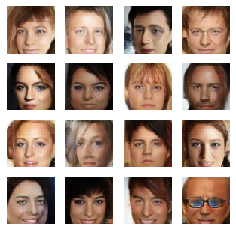

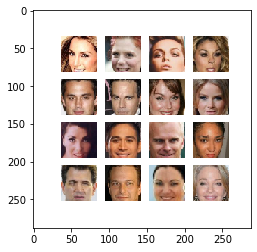

Time for epoch 123 is 210.66572523117065 sec
Gen_loss:  1.28878522 Disc_loss:  1.20997107
Gen_loss:  1.33873498 Disc_loss:  1.04054713
Gen_loss:  1.30599535 Disc_loss:  1.07544506
Gen_loss:  1.55844176 Disc_loss:  1.10683537
Gen_loss:  1.64853501 Disc_loss:  1.22197533
Gen_loss:  1.22314441 Disc_loss:  1.20306206
Gen_loss:  1.35397303 Disc_loss:  1.20754993
Gen_loss:  1.68053186 Disc_loss:  1.27044976
Gen_loss:  1.53022456 Disc_loss:  1.17745924
Gen_loss:  1.38177133 Disc_loss:  1.05668914
Gen_loss:  1.30966747 Disc_loss:  1.21393228
Gen_loss:  1.88888681 Disc_loss:  1.52675056
Gen_loss:  1.14852309 Disc_loss:  1.09159684
Gen_loss:  1.26613832 Disc_loss:  1.26258194
generate_and_save_images


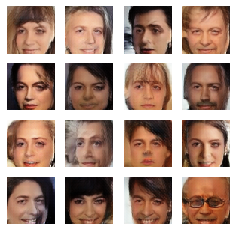

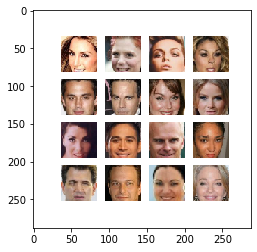

Time for epoch 124 is 211.18674683570862 sec
Gen_loss:  1.28163767 Disc_loss:  0.995533228
Gen_loss:  1.12103534 Disc_loss:  1.16249311
Gen_loss:  1.32341909 Disc_loss:  1.11984801
Gen_loss:  1.12939286 Disc_loss:  1.08189726
Gen_loss:  1.25434184 Disc_loss:  1.08643866
Gen_loss:  1.26388252 Disc_loss:  1.14112139
Gen_loss:  1.44292796 Disc_loss:  1.2503314
Gen_loss:  1.25472808 Disc_loss:  0.958882451
Gen_loss:  1.32312202 Disc_loss:  1.26936913
Gen_loss:  1.08259392 Disc_loss:  1.10281491
Gen_loss:  1.70540571 Disc_loss:  1.47939157
Gen_loss:  1.3655026 Disc_loss:  1.00943315
Gen_loss:  1.34700131 Disc_loss:  1.28122771
Gen_loss:  1.20518804 Disc_loss:  1.04472744
generate_and_save_images


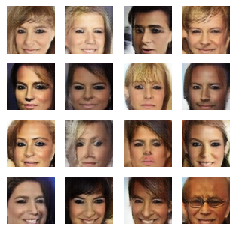

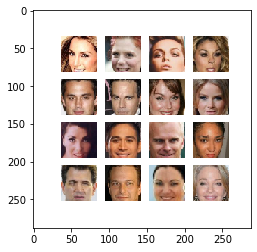

Time for epoch 125 is 211.1850655078888 sec
Gen_loss:  1.23807716 Disc_loss:  1.2295351
Gen_loss:  1.19125116 Disc_loss:  1.23660064
Gen_loss:  1.15365601 Disc_loss:  1.09013987
Gen_loss:  1.5623852 Disc_loss:  1.20276
Gen_loss:  1.25225902 Disc_loss:  1.00722539
Gen_loss:  1.34715796 Disc_loss:  1.0020299
Gen_loss:  1.37807453 Disc_loss:  1.07992411
Gen_loss:  1.43294501 Disc_loss:  1.00456274
Gen_loss:  1.12068856 Disc_loss:  1.06715918
Gen_loss:  1.40561938 Disc_loss:  1.18474507
Gen_loss:  1.27251482 Disc_loss:  1.25145054
Gen_loss:  1.19354939 Disc_loss:  1.02617848
Gen_loss:  1.10604978 Disc_loss:  1.04370928
Gen_loss:  1.49961495 Disc_loss:  1.12190843
generate_and_save_images


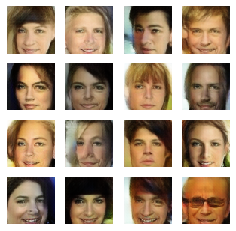

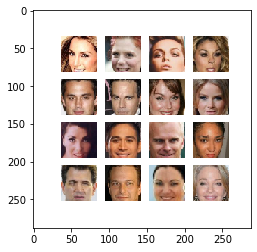

Time for epoch 126 is 212.38844347000122 sec


KeyboardInterrupt: 

In [34]:
%%time
train(train_dataset, EPOCHS)

# Create a GIF

In [39]:
anim_file = os.path.join(checkpoint_dir, current_time, 'dcgan.gif')

with imageio.get_writer(anim_file, mode='I') as writer:
    filenames = glob.glob(os.path.join(checkpoint_dir, current_time, 'image*.png'))
    filenames = sorted(filenames)
    last = -1
    for i,filename in enumerate(filenames):
        frame = 2*(i**0.5)
        if round(frame) > round(last):
            last = frame
        else:
            continue
        image = imageio.imread(filename)
        writer.append_data(image)
    image = imageio.imread(filename)
    writer.append_data(image)